# Name: Luke Pratley

# Training UNet Models
This notebook is where the training of different UNet models takes place.

- The image paths are read in as a list and passed to the data generator. 
- The data generator is used to read in batches of images during training and conserve memory. 
- The training takes process on a GPU, which has limited memory. Two different loss functions are used during training, the dice loss and the binary cross-entropy. 
- The final layer uses a sigmoid function, since since the building and road categories are independent (see the `final_data_process.ipynb` notebook) and due to viewing angle a building can cover a road leading them to lie on the same pixel.
- A dictionary of dictionaries is used to select a UNet architecture with a particular configuration.
- A training, validation, and test set are used. The validation set is used to pick the best model over 100 epochs of training and it is not later used for training. The test set is then used to calculate the final scores.
- The metric used to compare the detection against the ground truth is the [Intersection over Union](https://en.wikipedia.org/wiki/Jaccard_index) or IoU. It is a measure of how much the detection and ground truth labels overlap. The IoU is calculated as $${\rm IoU} = \frac{|Y \cap \hat{Y}|}{|Y \cup \hat{Y}|}\, $$ where $Y$ is the set of predicted classifications and $\hat{Y}$ is the set of ground truth classifications, and $|\cdot|$ is the cardinally of a set.

We start by importing modules:

In [1]:
import os
import numpy as np

import tensorflow.keras 
import tensorflow as tf
print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))


import PIL
import matplotlib.pyplot as plt
import pandas as pd

import math

import glob
import sys

from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report

sys.path.append('..')

import building_road_segmentation.unet_factory as unet_factory
import building_road_segmentation.optimization_factory as optimization_factory
import building_road_segmentation.data_generator as data_generator
import building_road_segmentation.loss_functions as loss_functions

Num GPUs Available:  1


We read in the list of image and mask paths. We also create a list of paths were both road and building labels are not censored, e.g., `filt_image_dir` and `filt_mask_dir`. We can choose these lists if we wish to train without having to censor when we are missing building or road labels for a particular image.

In [2]:
image_dir =  glob.glob("..\\data_cleaning_EDA\\final_images_small\\*AOI_2*") + glob.glob("..\\data_cleaning_EDA\\final_images_small\\*AOI_3*") + glob.glob("..\\data_cleaning_EDA\\final_images_small\\*AOI_4*") + glob.glob("..\\data_cleaning_EDA\\final_images_small\\*AOI_5*")
mask_dir =  glob.glob("..\\data_cleaning_EDA\\final_masks_small\\*AOI_2*") + glob.glob("..\\data_cleaning_EDA\\final_masks_small\\*AOI_3*") + glob.glob("..\\data_cleaning_EDA\\final_masks_small\\*AOI_4*") + glob.glob("..\\data_cleaning_EDA\\final_masks_small\\*AOI_5*")
filt_image_dir = []
filt_mask_dir = []
for p in range(len(image_dir)):
    s1 = image_dir[p].split('\\')[-1].replace('RGB-PanSharpen_', '').replace('.png', '')
    s2 = mask_dir[p].split('\\')[-1].replace('RGB-PanSharpen_', '').replace('.npy', '')
    assert s1 == s2
    mask = np.load(mask_dir[p])
    if (mask[:, :, 0] > 0).any() and (mask[:, :, 1] > 0).any():
        filt_image_dir.append(image_dir[p])
        filt_mask_dir.append(mask_dir[p])
    
assert len(mask_dir) == len(image_dir)
print(len(image_dir))

16739


We can compare the number of images that can be used with or without censoring labels:

In [3]:
print(len(image_dir))

16739


In [4]:
len(filt_image_dir)

8948

At this point we choose if we should use the dataset with censoring. We also create the training, validation, and test sets by first using 30% of the data for testing then taking a further 20% of the remaining data for validation.

While not shown here, I found from initial experimentation that using `filt_image_dir` and `filt_mask_dir` performed much better than keeping all of the data. Due to the large training time I ended up only sticking to data that had both building and road labels present.

In [5]:
train_image_dir, test_image_dir, train_mask_dir, test_mask_dir = train_test_split(filt_image_dir, filt_mask_dir, test_size=0.3, random_state=42)
train_image_dir, val_image_dir, train_mask_dir, val_mask_dir = train_test_split(train_image_dir, train_mask_dir, test_size=0.2, random_state=42)

In [6]:
print(f'The test set has {len(test_image_dir)} images')
print(f'The validation set has {len(val_image_dir)} images')

The test set has 2685 images
The validation set has 1253 images


In [7]:
train_data = data_generator.READ_AND_AUGMENT_DATA(train_image_dir, train_mask_dir, batch_size=64)
val_data = data_generator.READ_AND_AUGMENT_DATA(val_image_dir, val_mask_dir, batch_size=128)
test_data = data_generator.READ_AND_AUGMENT_DATA(test_image_dir, test_mask_dir, batch_size=128)

Here we define the loss functions. In principle, they can be weighted because the implementation supports this. We might want to do this because of the class imbalance (e.g., most pixels are not roads or buildings). However, with initial testing it was not clear that this would increase the intersection over union calculation. Due to the large training time the categorical weights were not leveraged during training, e.g. every class had the same weights.

In [8]:
losses = {'dice_loss' : loss_functions.weighted_dice_loss([1, 1]), 'BinaryCrossentropy': loss_functions.weighted_binary_crossentropy(np.array([1, 1]))}

Here we have a dictionary that stores the configuration for each model that we would like to train. The models with the suffix `_dice` use the dice loss and the models with the suffix `_entropy` use the categorical cross-entropy. If $y_k$ is a predicted label probability and $\hat{y}_k$ is the ground truth probability, then the binary cross-entropy for this label is calculated as: 
$${\rm BCE}({\bf y}, {\bf \hat{y}}) = \frac{1}{N}\sum_{k = 1}^N -\hat{y}_k\log y_k - (1 - \hat{y}_k)\log (1 -y_k)\,$$
If $y_k$ and  $\hat{y}_k$ are the predicted and ground truth label probabilities, the Dice loss is calculated as
$${\rm Dice}({\bf y}, {\bf \hat{y}}) = 2 - \frac{\sum_{k = 1}^N\hat{y}_k y_k}{\sum_{k = 1}^N \hat{y}_k + y_k}\, . $$

There are a number of models implemented for testing in this repository, all of which are variations of UNet:
- Original UNet ([U-Net: Convolutional Networks for Biomedical Image Segmentation, Ronneberger et al. (2015)](https://arxiv.org/abs/1505.04597)) (`model_dice` and `model_entropy`)
- Residual UNet ([A deep Residual U-Net convolutional neural network for automated lung segmentation in computed tomography images, Khanna et al. (2021)](https://www.sciencedirect.com/science/article/abs/pii/S0208521620300887)) (`res_model_dice` and `res_model_entropy`)
- Attention UNet ([Attention U-Net: Learning Where to Look for the Pancreas, Oktay et al. (2018)](https://arxiv.org/abs/1804.03999)) (`attention_model_dice` and `attention_model_entropy`)
- Residual Attention UNet ([Residual Attention U-Net for Semantic Segmentation of Cataract Surgical Instruments, Zhen-Liang et al.(2019)](https://arxiv.org/abs/1909.10360)) (Implemented but left out)
- EfficientNet UNet ([Eff-UNet: A Novel Architecture for Semantic Segmentation in Unstructured
Environment, Baheti et al. (2020)](https://ieeexplore.ieee.org/document/9150621)) (`efficient_model_dice` and `attention_model_entropy`)

In [9]:
model_configurations = {
                        'efficient_model_dice': {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'dice_loss'},
                        'efficient_model_entropy': {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'BinaryCrossentropy'},
                        'model_dice': {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'dice_loss'},
                        'model_entropy': {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'BinaryCrossentropy'},
                        'res_model_dice': {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': True, 'loss': 'dice_loss'},
                        'res_model_entropy': {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': True, 'loss': 'BinaryCrossentropy'},
                        'attention_model_dice': {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'dice_loss'},
                        'attention_model_entropy': {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'BinaryCrossentropy'},
                       }
optimizer = tf.keras.optimizers.Adam(learning_rate=1e-3)

The total number of models for training. The learning rate is fixed for all models and we use the Adam optimizer.

In [10]:
len(model_configurations)

8

If retrain is True, training will start from the last saved checkpoint. Otherwise, training will only be performed if the model has not been checkpoint-ed.

In [11]:
retrain=False

This loop constructs each of the models given the configuration.

The validation set is used to choose the best model weights out of 100 trained epochs. The best model weights are chosen by the largest `iou_metric`. This is done to curtail over-fitting and to stop performance after many iterations.

The models are saved during training. Keep in mind, **each model can take around 2 to 4 hours of training on a GPU**. Also, since the loss functions are custom objects, these functions need to be passed back to the loaded model.

The history object from the training is converted to a Pandas DataFrame and saved as a `.csv` file.

In [12]:
for model_name, model_config in model_configurations.items():
    print(model_name, model_config)
    tf.keras.backend.clear_session()
    if not os.path.exists(model_name):
        if model_name.split('_')[0] =='efficient':
                    unet_model = unet_factory.EfficientNetUNet(efficientnet=tensorflow.keras.applications.efficientnet.EfficientNetB4,
                                            number_of_categories=2,
                                            unet_levels=model_config['unet_levels'],
                                            number_of_start_kernels=model_config['number_of_start_kernels'],
                                            kernel_shape=(3, 3),
                                            activation='relu',
                                            final_activation='sigmoid',
                                            pooling_amount=model_config['pooling_amount'],
                                            dropout_rate=0.2, residual=model_config['residual'])
        if model_name.split('_')[0] =='attention':
            unet_model = unet_factory.BasicUNet(number_of_categories=2,
                                            unet_levels=model_config['unet_levels'],
                                            number_of_start_kernels=model_config['number_of_start_kernels'],
                                            kernel_shape=(3, 3),
                                            activation='relu',
                                            final_activation='sigmoid',
                                            pooling_amount=model_config['pooling_amount'],
                                            dropout_rate=0.2, residual=model_config['residual'])
        else:
            unet_model = unet_factory.BasicUNet(number_of_categories=2,
                                            unet_levels=model_config['unet_levels'],
                                            number_of_start_kernels=model_config['number_of_start_kernels'],
                                            kernel_shape=(3, 3),
                                            activation='relu',
                                            final_activation='sigmoid',
                                            pooling_amount=model_config['pooling_amount'],
                                            dropout_rate=0.2, residual=model_config['residual'])

    else:
        if retrain:
            unet_model = tf.keras.models.load_model(model_name, custom_objects={model_config['loss']: losses[model_config['loss']]})
    if not os.path.exists(model_name) or retrain:
        modelcheckpoint = tf.keras.callbacks.ModelCheckpoint(filepath=model_name, 
                            monitor='val_iou_metric',
                            mode='max',
                            save_best_only=True, save_format='tf')
        unet_model.compile(optimizer=optimizer, loss=losses[model_config['loss']], metrics=[loss_functions.masked_accuracy(), loss_functions.masked_iou_metric()])
        history = unet_model.fit(train_data, epochs=100, validation_data=val_data, callbacks=[modelcheckpoint])
        history =  pd.DataFrame(history.history)
        if os.path.exists(f'{model_name}_history.csv'):
            history_old = pd.read_csv(model_name +'_history.csv', index_col=0)
            history = pd.concat((history_old , history), axis=0, ignore_index=True)
        history.to_csv(f'{model_name}_history.csv')  
        

efficient_model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'dice_loss'}
efficient_model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'BinaryCrossentropy'}
model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'dice_loss'}
model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'BinaryCrossentropy'}
res_model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': True, 'loss': 'dice_loss'}
res_model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': True, 'loss': 'BinaryCrossentropy'}
attention_model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'dice_loss'}
attention_model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 

Here we briefly plot the output in the history object:
- The per pixel accuracy on average for training and validation sets as a function of epoch.
- The loss on average for training and validation sets as a function of epoch.
- The iou on average for training and validation sets as a function of epoch.

Generally, speaking the model performs 1 to 2 percent better on the training sets than the validation sets, which is what we expect if we are not under fitting.

Plotting efficient_model_dice
Plotting efficient_model_entropy
Plotting model_dice
Plotting model_entropy
Plotting res_model_dice
Plotting res_model_entropy
Plotting attention_model_dice
Plotting attention_model_entropy


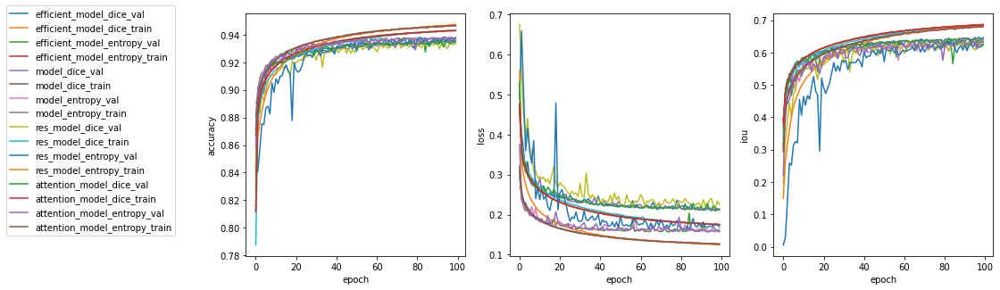

In [13]:
histories = {}
count = 0
fig, ax = plt.subplots(1, 3, sharex=True, sharey=False, figsize=(15,5))
for model_name, model_config in model_configurations.items():
    print(f"Plotting {model_name}")
    if os.path.exists(model_name):
        history = pd.read_csv(model_name +'_history.csv', index_col=0)
        histories[model_name] = history
        if np.mean(history['val_loss']) <0.5:    
            ax[0].plot(history['val_accuracy'], label=model_name+'_val')
            ax[0].set_ylabel('accuracy')
            ax[0].plot(history['accuracy'], label=model_name +'_train')
            ax[0].set_ylabel('accuracy')
            ax[0].set_xlabel('epoch')
            ax[1].plot(history['val_loss'])
            ax[1].plot(history['loss'])
            ax[1].set_ylabel('loss')
            ax[1].set_xlabel('epoch')
            ax[2].plot(history['val_iou_metric'])
            ax[2].plot(history['iou_metric'])
            ax[2].set_ylabel('iou')
            ax[2].set_xlabel('epoch')
ax[0].legend(bbox_to_anchor=(-.3, 1.05))
plt.show()

Here we calculate the iou metric for the extracted building and road features against the test set. These calculations are kept aside for performing a hypothesis test to choose what the best performing models are.

The models are loaded with each iteration.

In [14]:
model_metrics = {}
import pickle
for model_name, model_config in model_configurations.items():
    if os.path.exists(model_name):
        model_metrics[model_name] = {'road_iou': {'AOI_2_Vegas': [], 'AOI_3_Paris': [], 'AOI_4_Shanghai' : [], 'AOI_5_Khartoum': []}, 
                                 'building_iou': {'AOI_2_Vegas': [], 'AOI_3_Paris': [], 'AOI_4_Shanghai' : [], 'AOI_5_Khartoum': []},
                                    'road_file': {'AOI_2_Vegas': [], 'AOI_3_Paris': [], 'AOI_4_Shanghai' : [], 'AOI_5_Khartoum': []},
                                    'road_index': {'AOI_2_Vegas': [], 'AOI_3_Paris': [], 'AOI_4_Shanghai' : [], 'AOI_5_Khartoum': []},
                                    'building_file': {'AOI_2_Vegas': [], 'AOI_3_Paris': [], 'AOI_4_Shanghai' : [], 'AOI_5_Khartoum': []},
                                    'building_index': {'AOI_2_Vegas': [], 'AOI_3_Paris': [], 'AOI_4_Shanghai' : [], 'AOI_5_Khartoum': []},
                                    }
        tf.keras.backend.clear_session()
        #here we load the model with the custom objects
        final_model = tf.keras.models.load_model(model_name, custom_objects={model_config['loss']: losses[model_config['loss']], 'iou_metric': loss_functions.masked_iou_metric()})
        print(model_name, model_config)
        y_pred = final_model.predict(test_data)
        y_pred = np.where(y_pred > 0.5, 1, 0)
        batch_size = test_data.batch_size
        test_data.batch_size = 1
        for k in range(y_pred.shape[0]):
            for key in model_metrics[model_name]['road_iou'].keys():
                if key in test_data.y[k][0]:
                    # here we choose the correct path from the test set and calculate/store the IoU scores for analysis in the next notebook.
                    y_test = test_data.__getitem__(k)[1][0]
                    if np.sum(y_test[:, :, 0]) > 0:
                        model_metrics[model_name]['road_iou'][key].append(loss_functions.intersection_over_union(y_test[:, :, 0], y_pred[k, :, :, 0]))
                        model_metrics[model_name]['road_file'][key].append(test_data.y[k][0])
                        model_metrics[model_name]['road_index'][key].append(k)
                    if np.sum(y_test[:, :, 1]) > 0:
                        model_metrics[model_name]['building_iou'][key].append(loss_functions.intersection_over_union(y_test[:, :, 1], y_pred[k, :, :, 1]))
                        model_metrics[model_name]['building_file'][key].append(test_data.y[k][0])
                        model_metrics[model_name]['building_index'][key].append(k)
        test_data.batch_size = batch_size
print('saving_test_results....')
# Here the IoU scores are saved into a .pkl file
with open('iou_metric_test_results.pkl', 'wb') as file:
    pickle.dump(model_metrics, file)

efficient_model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'dice_loss'}
efficient_model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'BinaryCrossentropy'}
model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'dice_loss'}
model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'BinaryCrossentropy'}
res_model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': True, 'loss': 'dice_loss'}
res_model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': True, 'loss': 'BinaryCrossentropy'}
attention_model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'dice_loss'}
attention_model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 

In [15]:
def plot_metrics(model_metrics, model_name):
    """
    A function that plots the IoU metrics 
    for each model and area of interest 
    for roads and buildings.
    
    Inputs:
        model_metrics: the dictionary containing the saved IoU scores for each image.
        model_name: the name of the model which is used as a dictionary key for model_metrics
    """
    fig, ax = plt.subplots(1, 4, sharex=True, sharey=True, figsize=(10, 2))
    plt.suptitle(f'Road Average IoU per Image ({model_name})')
    ax = np.ravel(ax)
    all_values = []
    for k, key in enumerate(model_metrics[model_name]['road_iou'].keys()):
        all_values = np.concatenate((all_values, model_metrics[model_name]['road_iou'][key]))
        model_metrics[model_name]['road_iou'][key] = np.array(model_metrics[model_name]['road_iou'][key])   
        ax[k].hist(model_metrics[model_name]['road_iou'][key], density=True, alpha=0.5, bins=np.arange(0, 1.05, 0.05), label=key, color=['green', 'red', 'navy', 'purple'][k])
        ax[k].legend()
        ax[k].set_xlabel('IoU')
        ax[k].axvline(np.median(model_metrics[model_name]['road_iou'][key]))
    print(f'The median IoU for roads is {np.median(all_values): 0.4f}')
    ax[0].set_ylabel('Density')
    plt.show()
    all_values = []
    fig, ax = plt.subplots(1, 4, sharex=True, sharey=True, figsize=(10, 2))
    fig.suptitle(f'Building Average IoU per Image ({model_name})')
    ax = np.ravel(ax)
    for k, key in enumerate(model_metrics[model_name]['building_iou'].keys()):
        all_values = np.concatenate((all_values, model_metrics[model_name]['building_iou'][key]))
        model_metrics[model_name]['building_iou'][key] = np.array(model_metrics[model_name]['building_iou'][key])
        ax[k].hist(model_metrics[model_name]['building_iou'][key], density=True, alpha=0.5, bins=np.arange(0, 1.05, 0.05), label=key, color=['green', 'red', 'navy', 'purple'][k])
        ax[k].legend()
        ax[k].set_xlabel('IoU')
        ax[k].axvline(np.median(model_metrics[model_name]['building_iou'][key]))
    print(f'The median IoU for buildings is {np.median(all_values): 0.4f}')
    ax[0].set_ylabel('Density')
    plt.show()

Here we plot histograms of the results calculated above. The vertical blue line shows the location of the median IoU for each area of interest.

The printed out IoU value is the median for all images in the dataset.

efficient_model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'dice_loss'}
The median IoU for roads is  0.6574


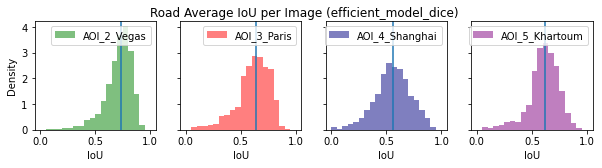

The median IoU for buildings is  0.6892


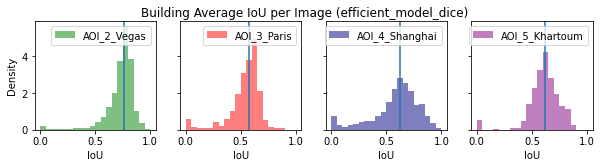

efficient_model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'BinaryCrossentropy'}
The median IoU for roads is  0.6518


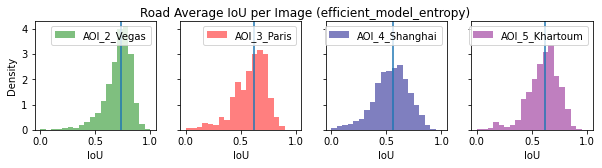

The median IoU for buildings is  0.6827


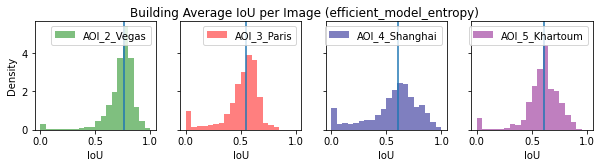

model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'dice_loss'}
The median IoU for roads is  0.6569


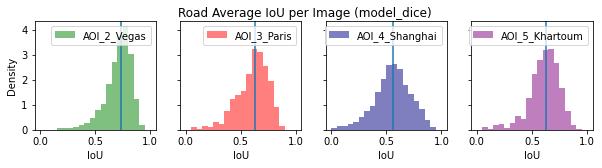

The median IoU for buildings is  0.6917


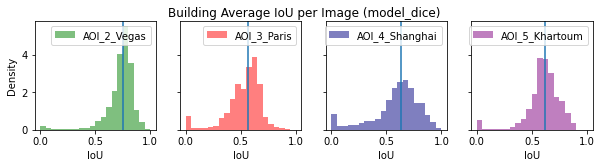

model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'BinaryCrossentropy'}
The median IoU for roads is  0.6481


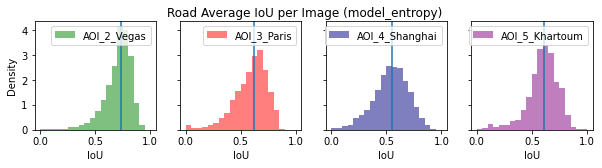

The median IoU for buildings is  0.6861


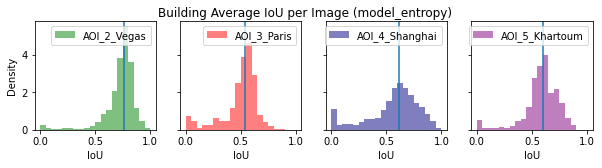

res_model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': True, 'loss': 'dice_loss'}
The median IoU for roads is  0.6585


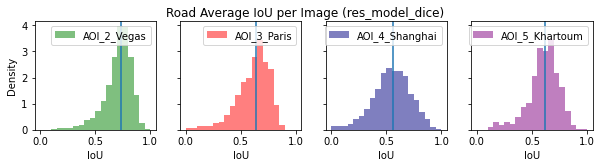

The median IoU for buildings is  0.6787


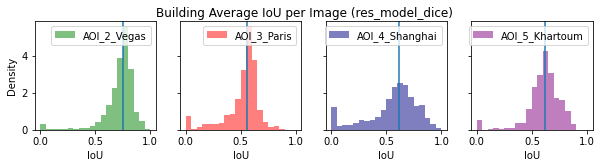

res_model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': True, 'loss': 'BinaryCrossentropy'}
The median IoU for roads is  0.6518


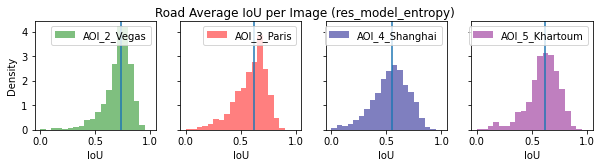

The median IoU for buildings is  0.6827


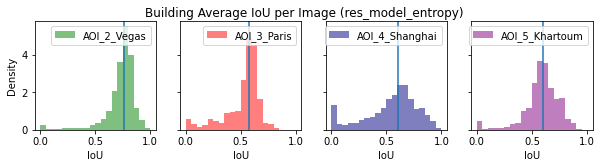

attention_model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'dice_loss'}
The median IoU for roads is  0.6602


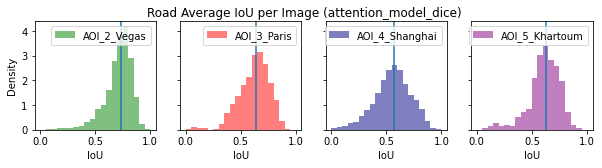

The median IoU for buildings is  0.6879


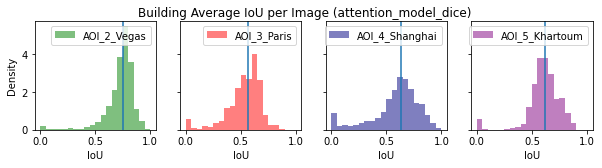

attention_model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'BinaryCrossentropy'}
The median IoU for roads is  0.6609


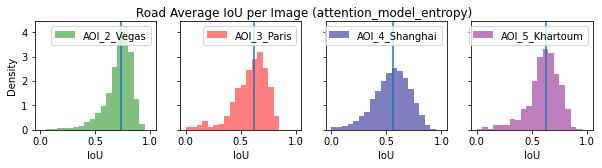

The median IoU for buildings is  0.6815


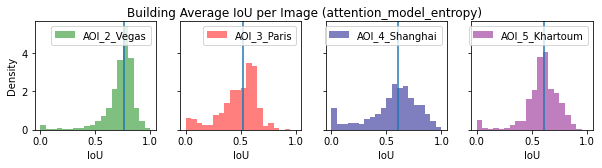

In [16]:
for model_name in model_configurations.keys():
    if os.path.exists(model_name):
        if np.mean(histories[model_name]['val_loss']) < 0.5:
            print(model_name, model_configurations[model_name])
            plot_metrics(model_metrics, model_name)

Here is where we can inspect the input and output for the test dataset:

In [17]:
from matplotlib.colors import ListedColormap
from matplotlib.patches import Patch

def plot_result(X_test, y_test, model_name, display_prob, index=0):
    """
    A function that visually the compares the feature extraction 
    results for predicted and ground truth labels for a chosen model.
    
    Inputs:
        X_test: A list of paths to RGB images.
        y_test: A list of paths to the building and road network labels.
        model_name: The name of the model to make a prediction.
        display_prob: If true, it will display the probability rather than True or False for the pixel-wise classifications.
        index: The index for X_test and y_test for the image and labels to be displayed.
    """
    # load the model for inference
    final_model = tf.keras.models.load_model(model_name, custom_objects={model_config['loss']: losses[model_config['loss']], 'iou_metric': loss_functions.masked_iou_metric()})
    y_pred = final_model.predict(X_test)
    # make a hard prediction
    if not display_prob:
        y_pred = np.where(y_pred > 0.5, 1, 0)
    # plot the outputs
    fig, ax = plt.subplots(2, 3, figsize=(15, 8), sharex=True, sharey=True)
    ax[1, 0].set_title('Image')
    ax[1, 0].imshow(X_test_batch[index, :, :])
    ax[0, 0].set_title('Labels')
    ax[0, 0].imshow(y_test[index, :, :, 0] * 10 + y_test[index, :, :, 1] * 20, cmap = ListedColormap(['navy','green','purple']))
    ax[0, 0].legend(handles=[Patch(facecolor='navy', edgecolor='navy',
                     label='Background'), Patch(facecolor='green', edgecolor='green',
                     label='Road Network'), Patch(facecolor='purple', edgecolor='purple',
                     label='Building')], loc="best", bbox_to_anchor=(1.05, 1))
    ax[1, 1].set_title('True Road Network')
    ax[1, 1].imshow(y_test[index, :, :, 0], vmin = 0, vmax=1)
    ax[1, 2].set_title('True Building Footprint')
    ax[1, 2].imshow(y_test[index, :, :, 1], vmin = 0, vmax=1)
    ax[0, 1].set_title('Predicted Road Network')
    ax[0, 1].imshow(y_pred[index, :, :, 0], vmin = 0, vmax=1)
    ax[0, 2].set_title('Predicted Building Footprint')
    ax[0, 2].imshow(y_pred[index, :, :, 1], vmin = 0, vmax=1)

There are thousands of images and predicted extracted features that we can compare. To get a feel for what to expect visually, we pick images that have an IoU close to the median value for roads and buildings. 
We pick the images that are close to the best and median IoU for each area of interest using the efficientnet UNet model trained with the dice loss:

In [18]:
model_name ='efficient_model_dice'
areas_of_interest = model_metrics[model_name]['building_index'].keys()
#find the index for the image with the largest IoU across buildings/roads for each area of interest
best_building_index = [model_metrics[model_name]['building_index'][k][np.argmax(model_metrics[model_name]['building_iou'][k])] for k in areas_of_interest]
best_road_index = [model_metrics[model_name]['road_index'][k][np.argmax(model_metrics[model_name]['road_iou'][k])] for k in areas_of_interest]
#find the index for the image closest to the median IoU across buildings/roads for each area of interest
median_building_index = [model_metrics[model_name]['building_index'][k][np.argmin(np.abs(np.median(model_metrics[model_name]['building_iou'][k]) - model_metrics[model_name]['building_iou'][k]))] for k in areas_of_interest]
median_road_index = [model_metrics[model_name]['road_index'][k][np.argmin(np.abs(np.median(model_metrics[model_name]['road_iou'][k]) - model_metrics[model_name]['road_iou'][k]))] for k in areas_of_interest]

# Median IoU Example building extraction for each area of interest

('..\\data_cleaning_EDA\\final_images_small\\AOI_2_Vegas_img50.png', <Augment.ROT90: 4>)
('..\\data_cleaning_EDA\\final_masks_small\\AOI_2_Vegas_img50.npy', <Augment.ROT90: 4>)


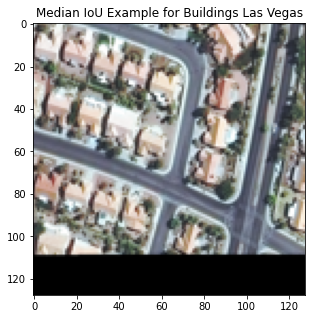

efficient_model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'dice_loss'}


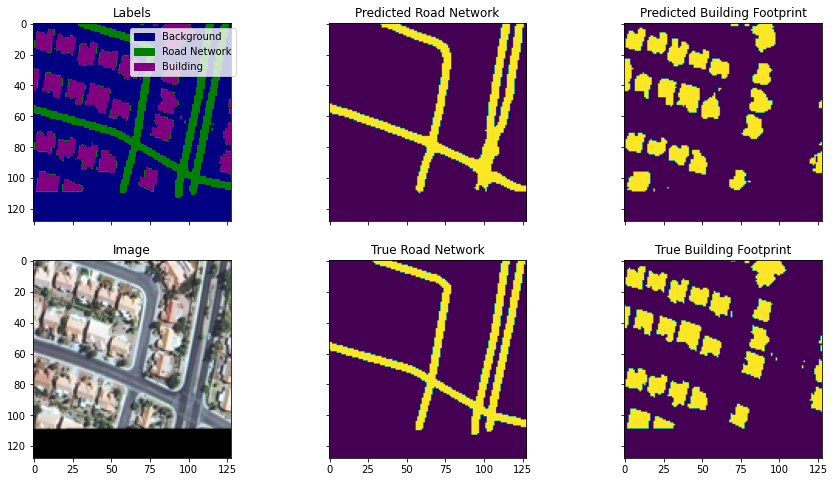

efficient_model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'BinaryCrossentropy'}


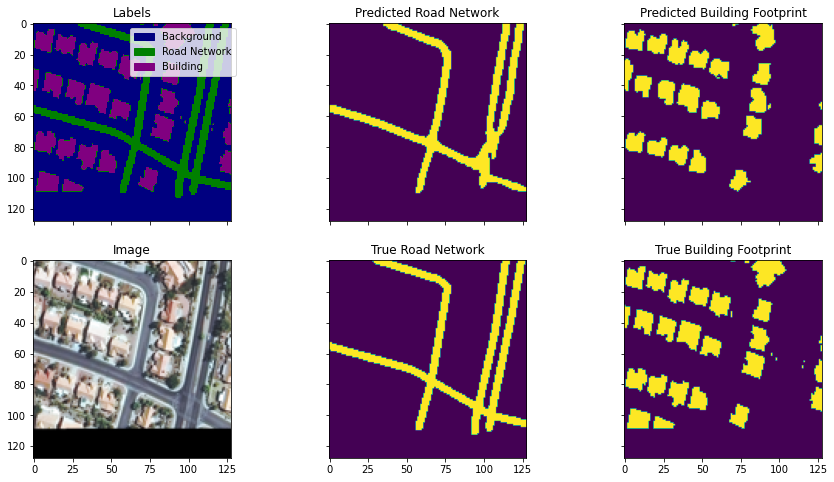

model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'dice_loss'}


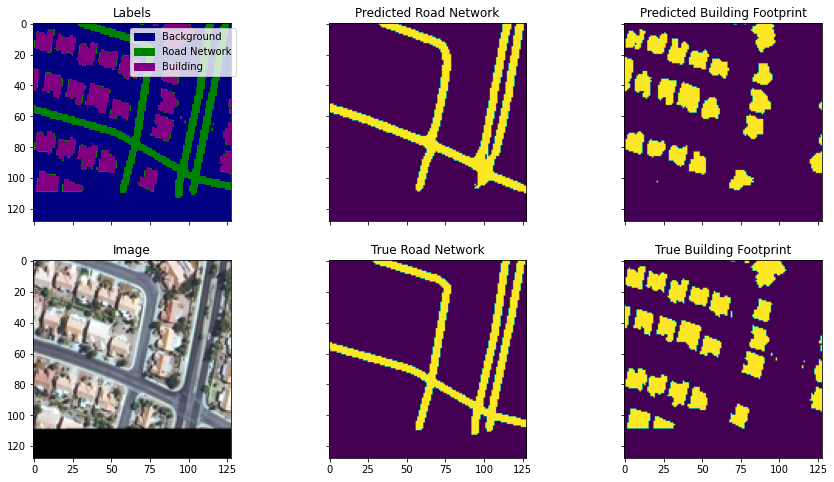

model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'BinaryCrossentropy'}


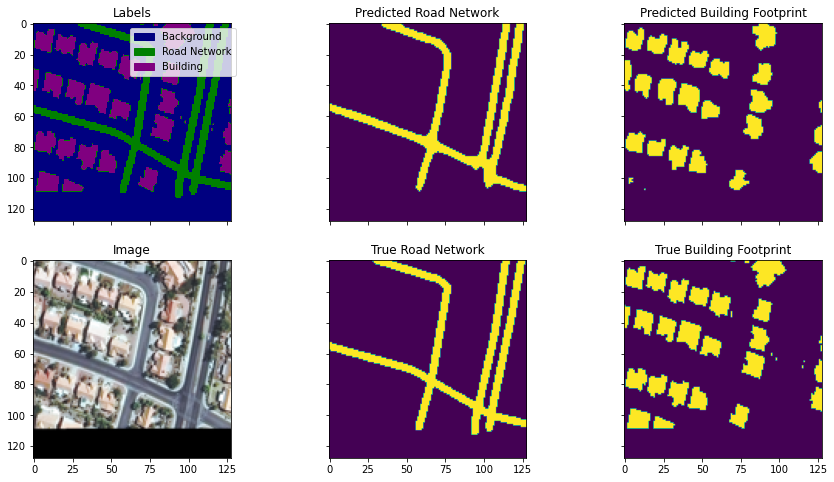

res_model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': True, 'loss': 'dice_loss'}


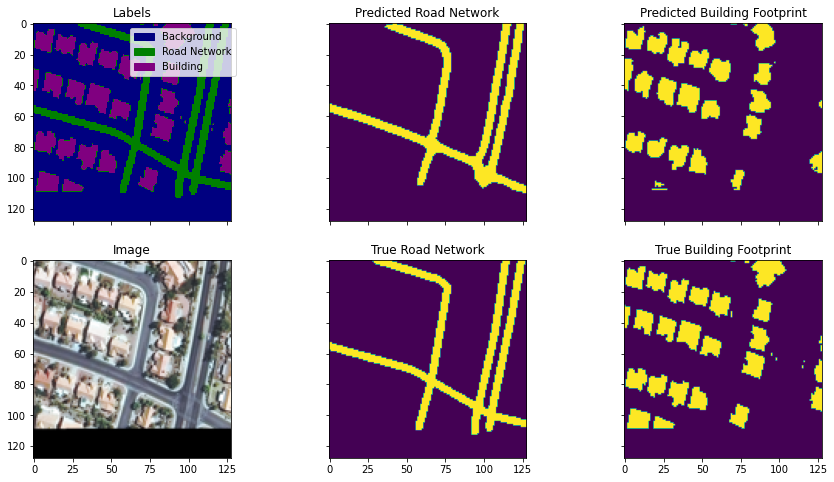

res_model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': True, 'loss': 'BinaryCrossentropy'}


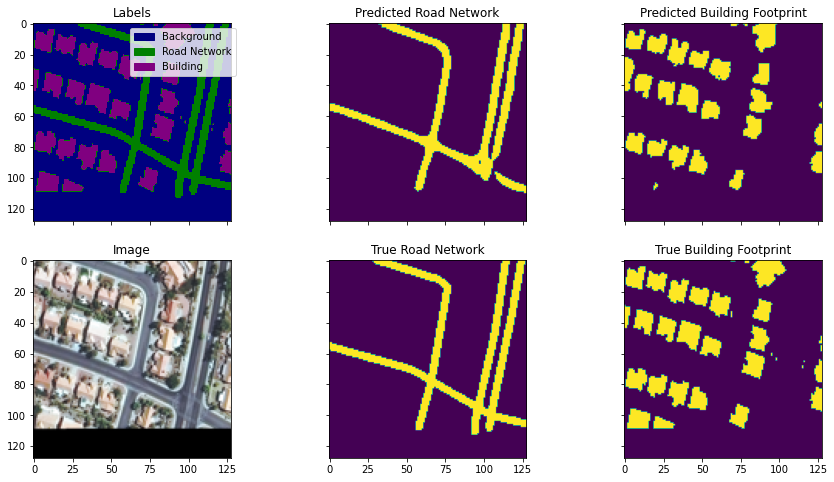

attention_model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'dice_loss'}


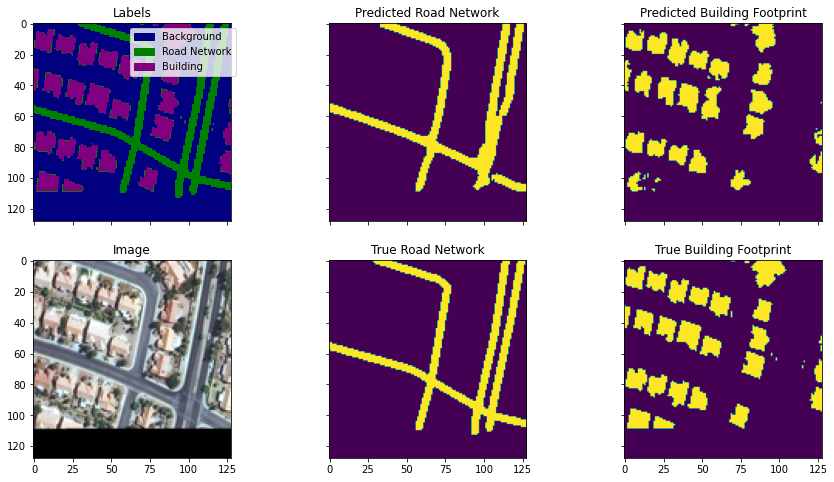

attention_model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'BinaryCrossentropy'}


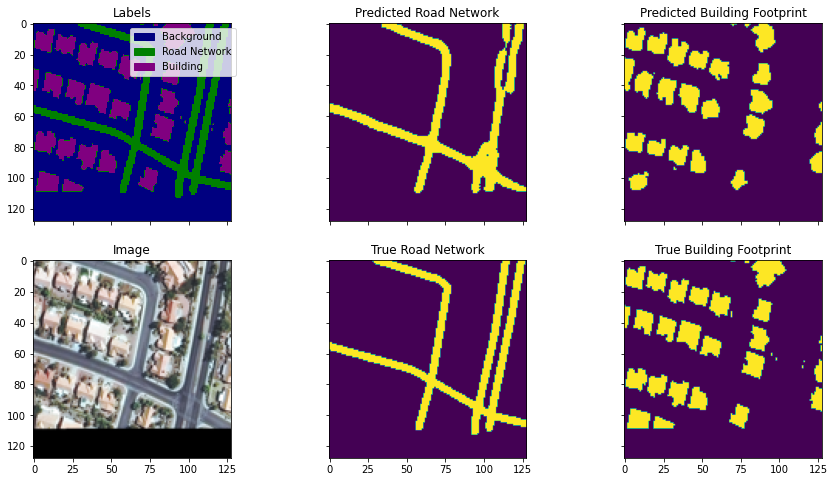

('..\\data_cleaning_EDA\\final_images_small\\AOI_3_Paris_img862.png', <Augment.LRFLIP: 2>)
('..\\data_cleaning_EDA\\final_masks_small\\AOI_3_Paris_img862.npy', <Augment.LRFLIP: 2>)


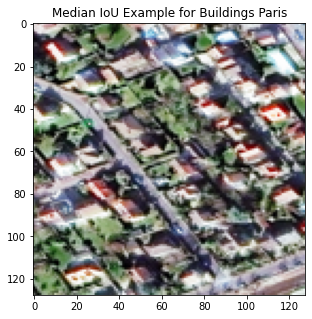

efficient_model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'dice_loss'}


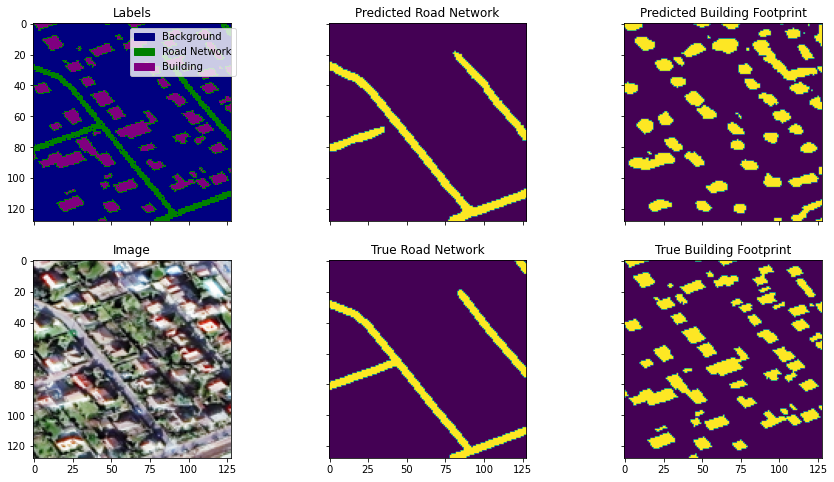

efficient_model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'BinaryCrossentropy'}


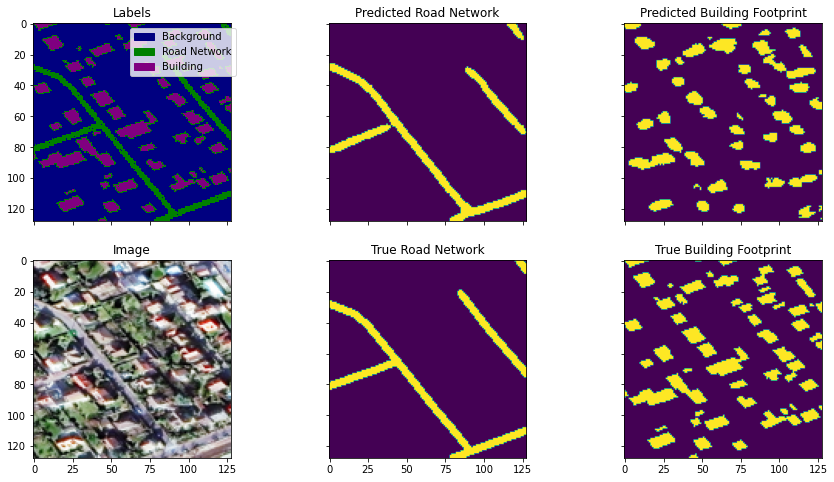

model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'dice_loss'}


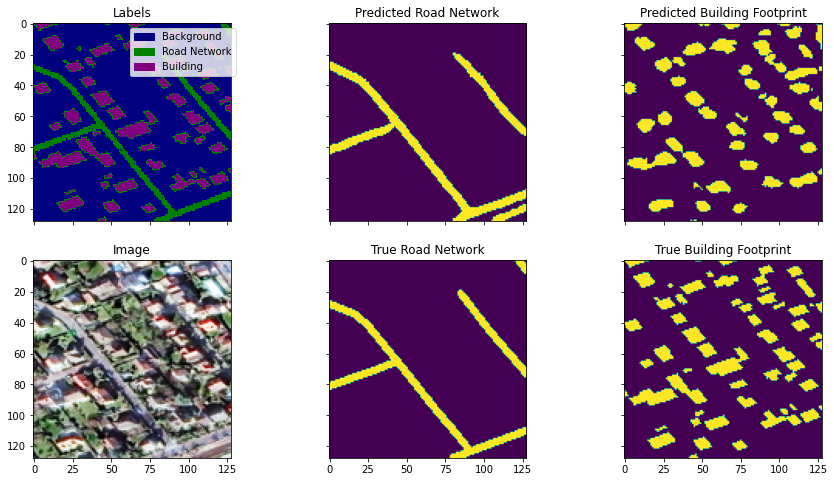

model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'BinaryCrossentropy'}


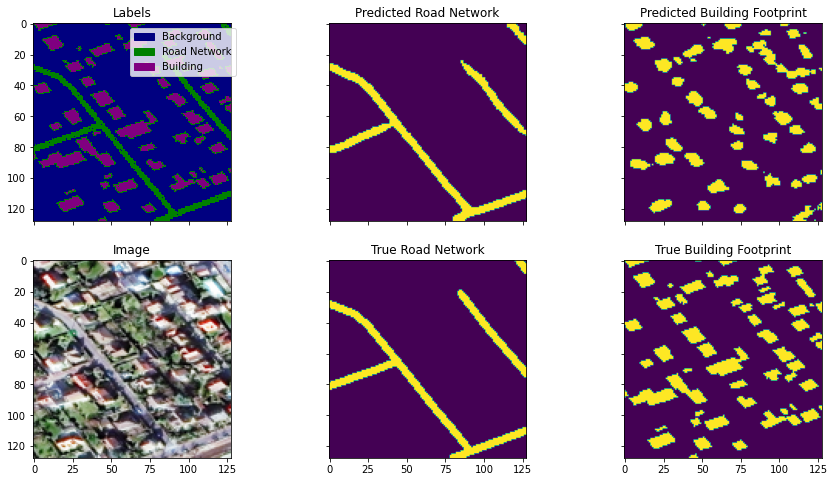

res_model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': True, 'loss': 'dice_loss'}


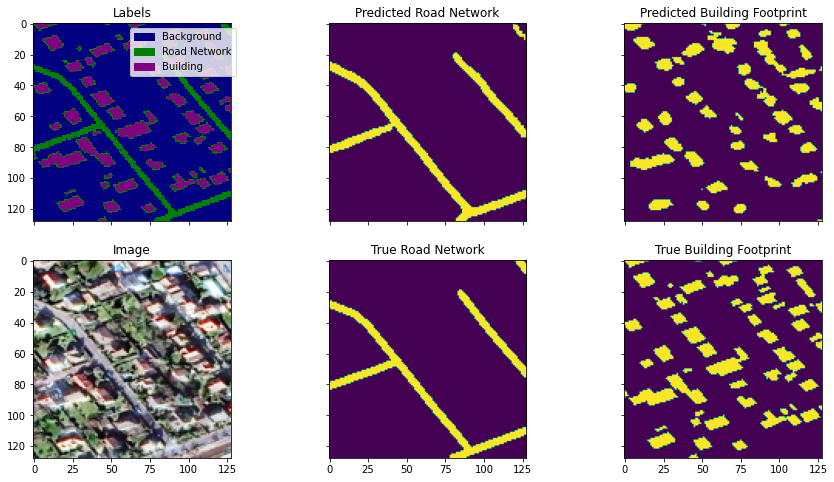

res_model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': True, 'loss': 'BinaryCrossentropy'}


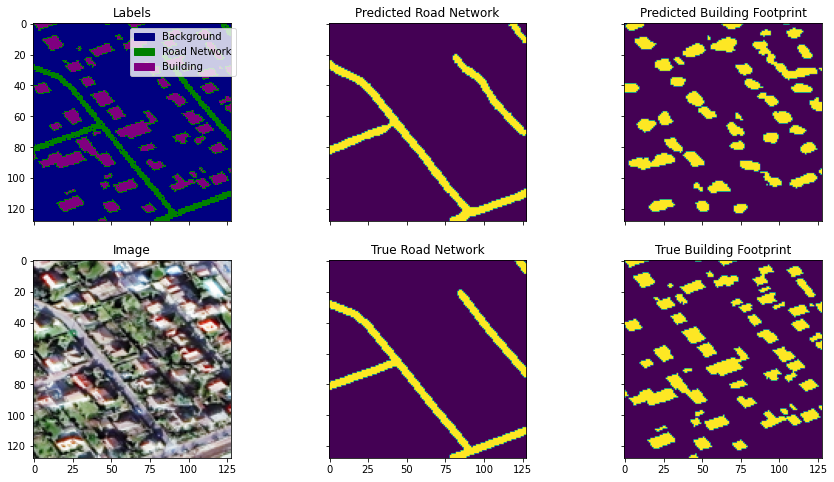

attention_model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'dice_loss'}


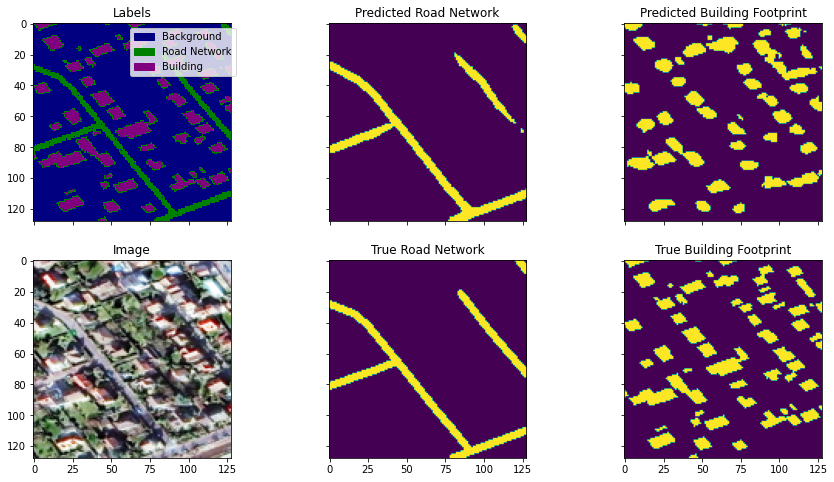

attention_model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'BinaryCrossentropy'}


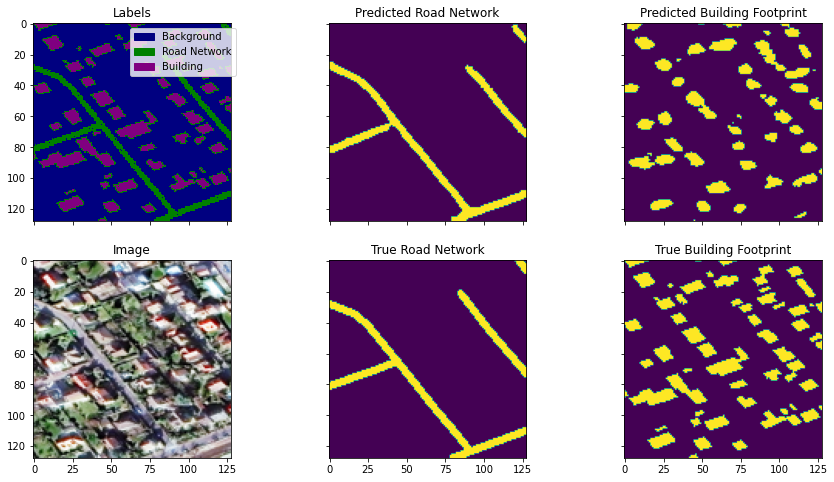

('..\\data_cleaning_EDA\\final_images_small\\AOI_4_Shanghai_img3774.png', <Augment.ORIGINAL: 1>)
('..\\data_cleaning_EDA\\final_masks_small\\AOI_4_Shanghai_img3774.npy', <Augment.ORIGINAL: 1>)


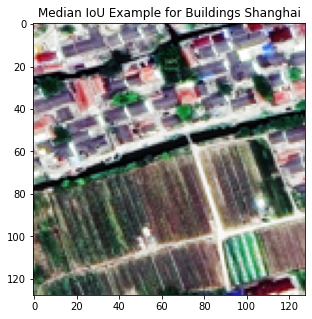

efficient_model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'dice_loss'}


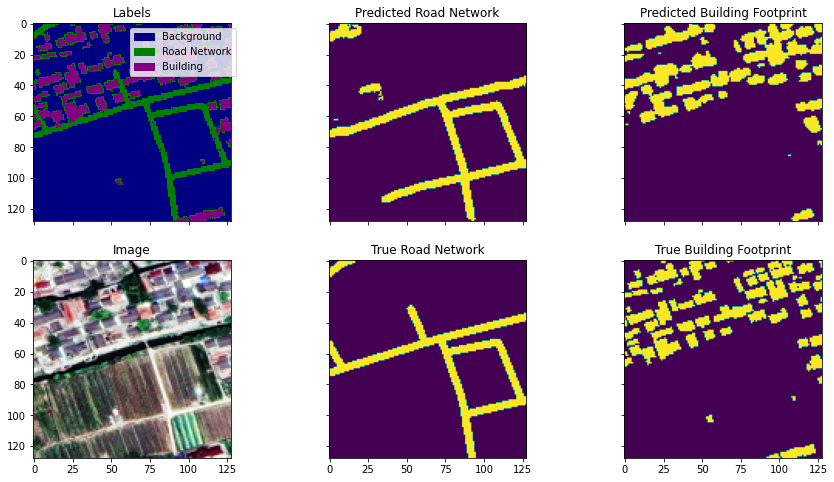

efficient_model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'BinaryCrossentropy'}


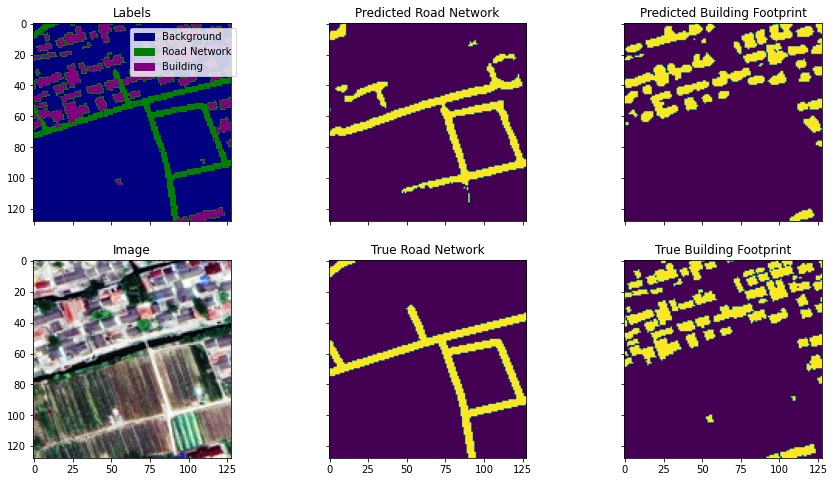

model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'dice_loss'}


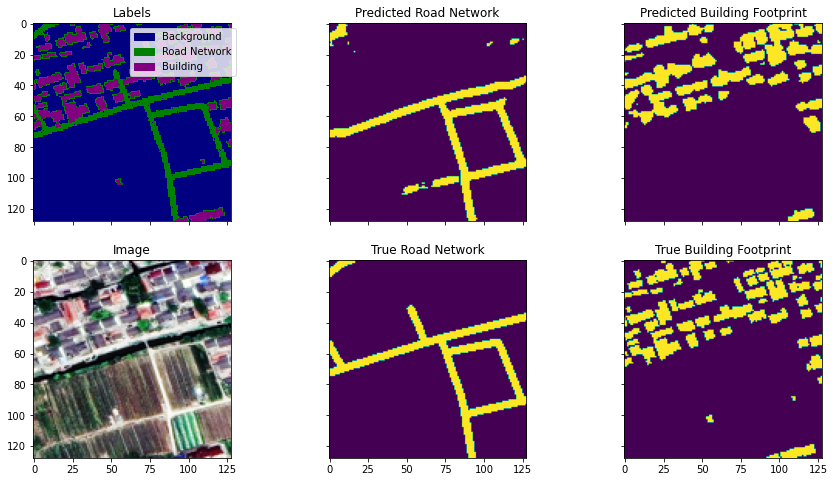

model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'BinaryCrossentropy'}


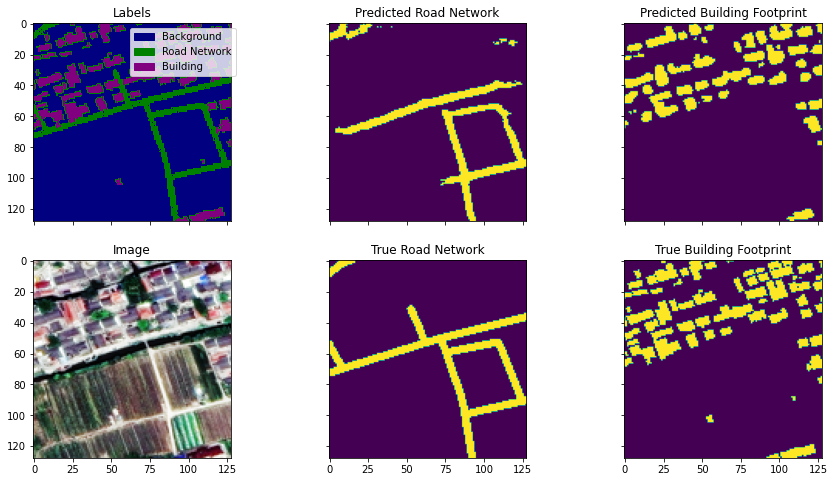

res_model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': True, 'loss': 'dice_loss'}


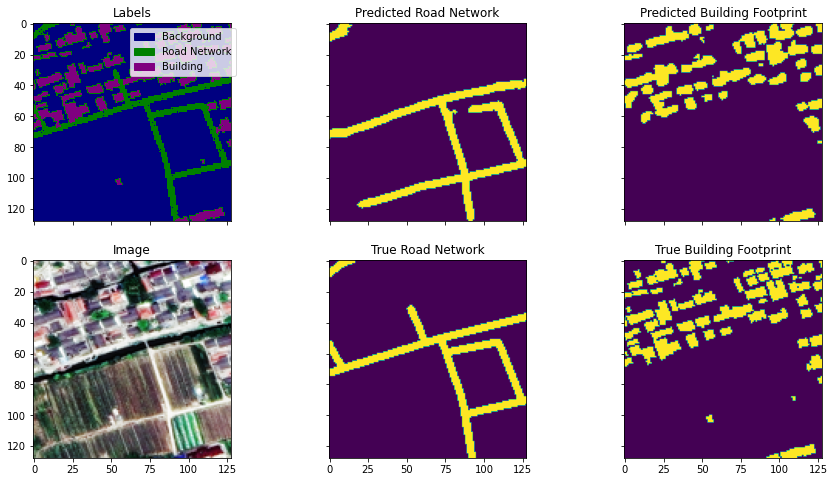

res_model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': True, 'loss': 'BinaryCrossentropy'}


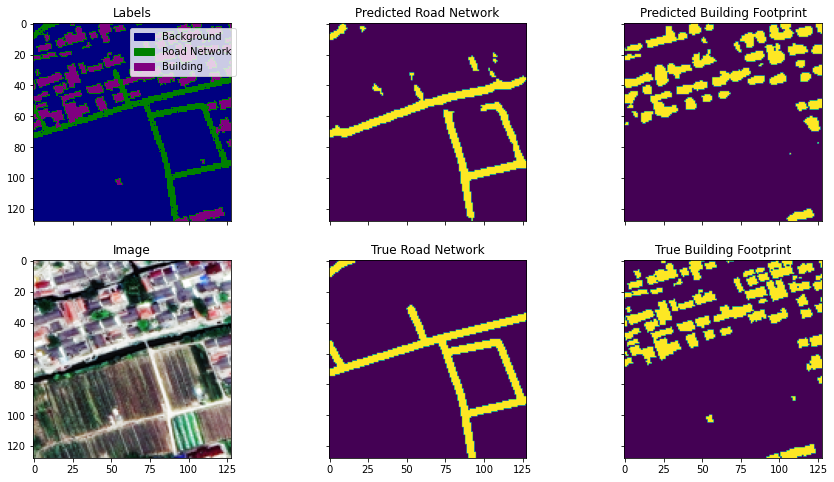

attention_model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'dice_loss'}


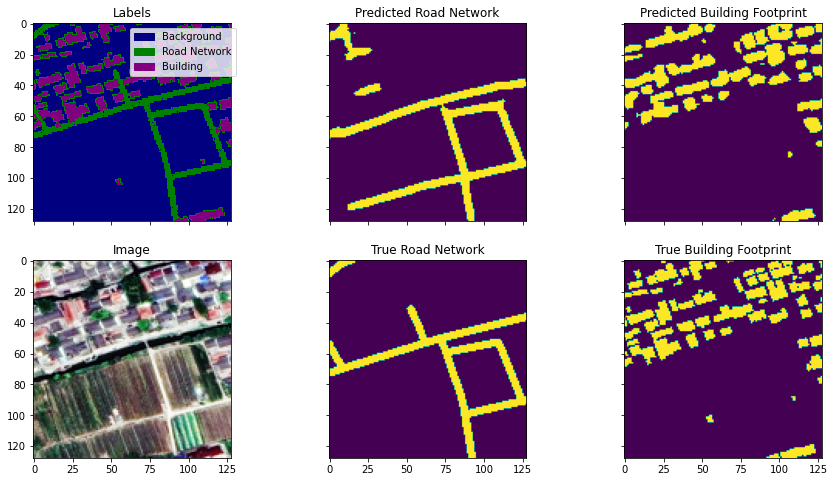

attention_model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'BinaryCrossentropy'}


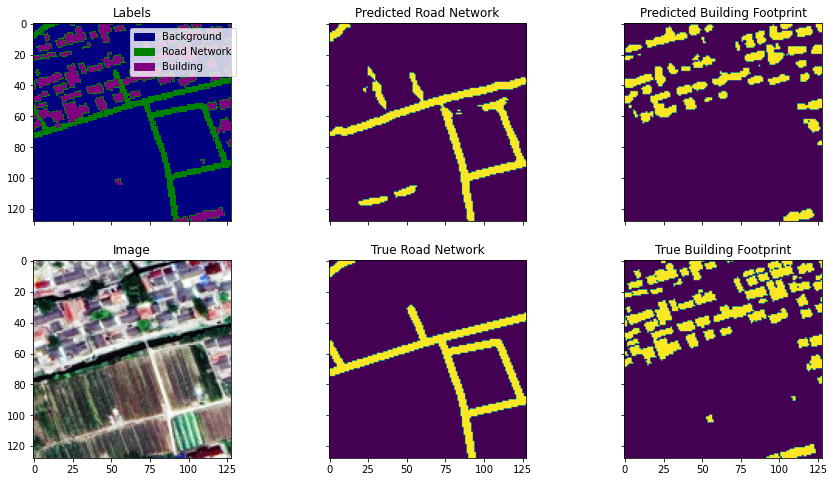

('..\\data_cleaning_EDA\\final_images_small\\SN3_roads_train_AOI_5_Khartoum_PS-RGB_img286_b.png', <Augment.ROT90: 4>)
('..\\data_cleaning_EDA\\final_masks_small\\SN3_roads_train_AOI_5_Khartoum_PS-RGB_img286_b.npy', <Augment.ROT90: 4>)


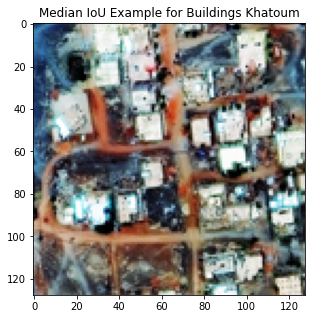

efficient_model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'dice_loss'}


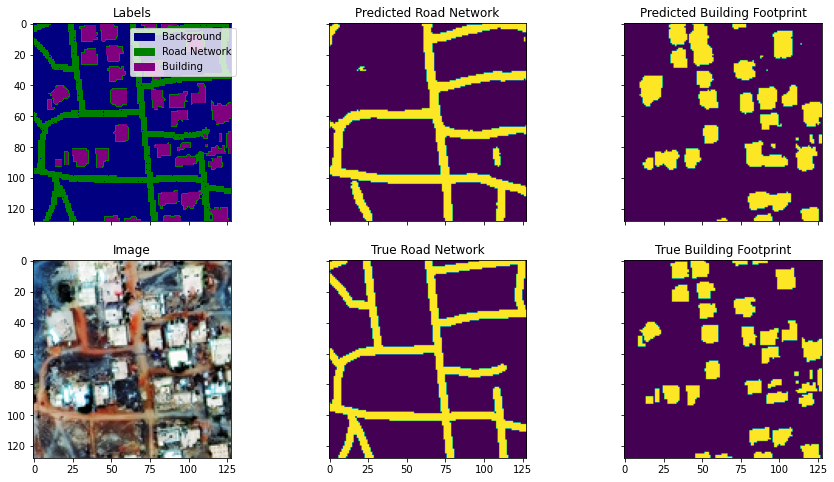

efficient_model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'BinaryCrossentropy'}


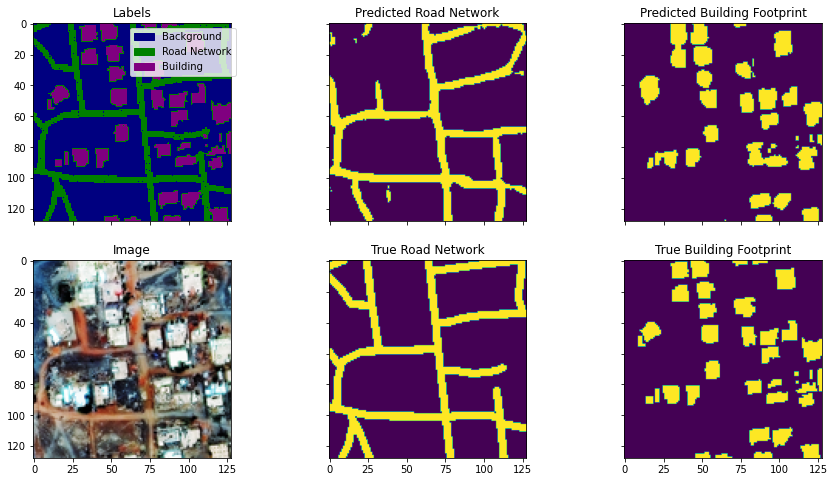

model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'dice_loss'}


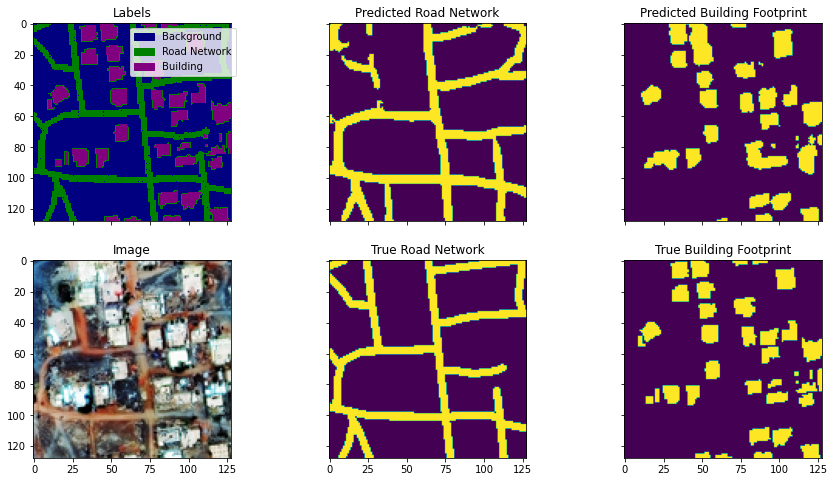

model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'BinaryCrossentropy'}


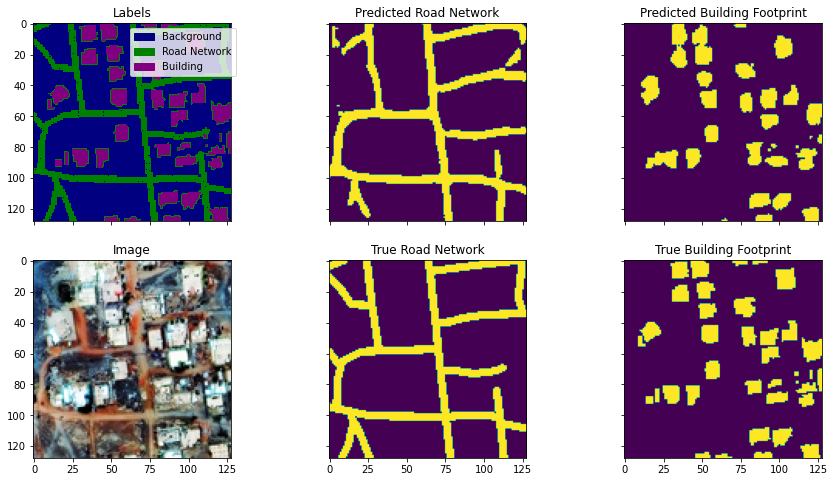

res_model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': True, 'loss': 'dice_loss'}


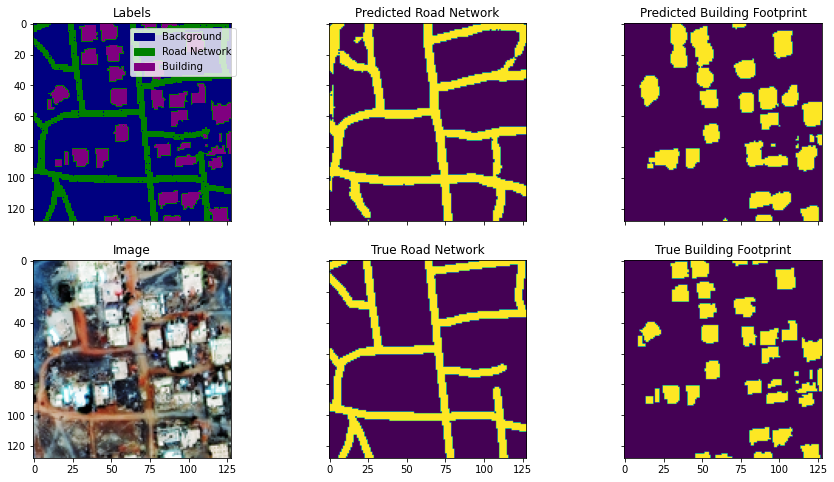

res_model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': True, 'loss': 'BinaryCrossentropy'}


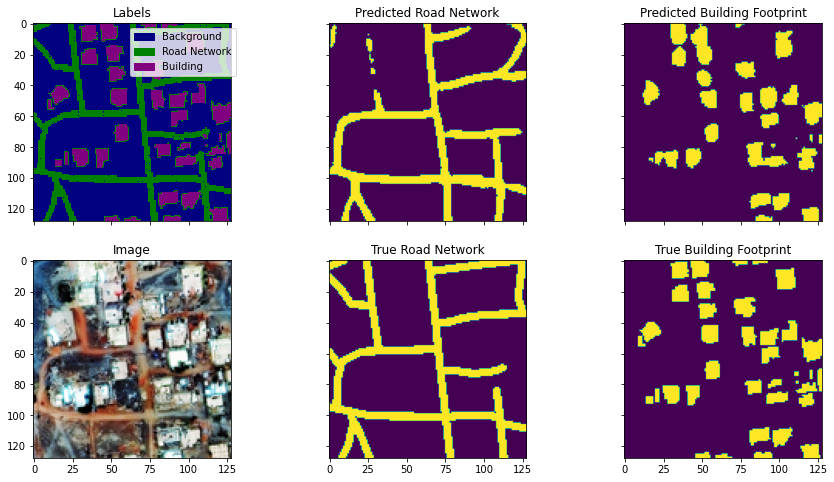

attention_model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'dice_loss'}


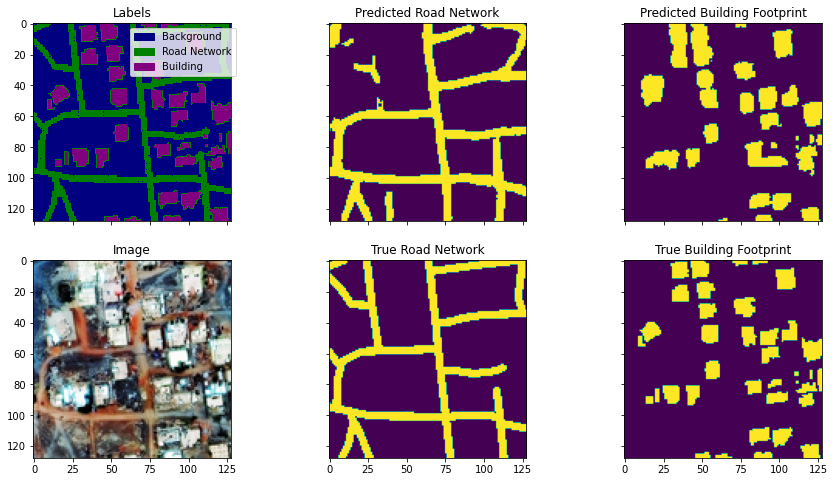

attention_model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'BinaryCrossentropy'}


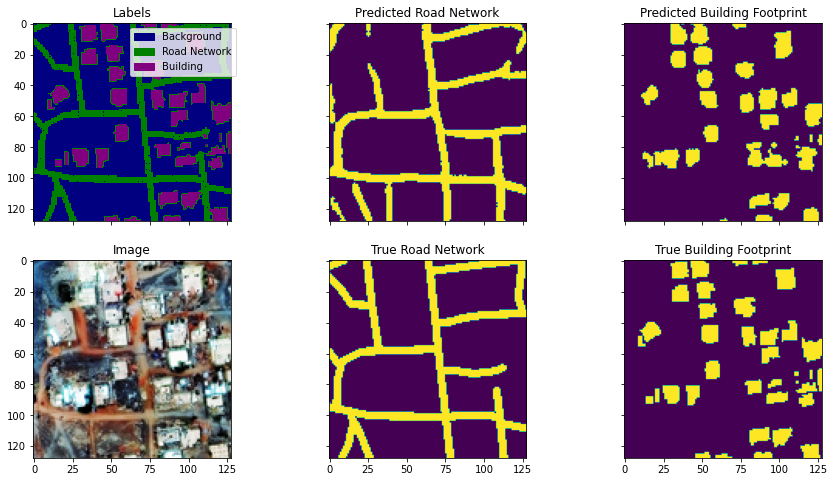

In [19]:
for g, aoi in enumerate(["Las Vegas", "Paris", "Shanghai", "Khatoum"]):
    k= median_building_index[g]

    batch = math.floor(k / test_data.batch_size) 
    index = k - batch * test_data.batch_size
    print(test_data.x[k])
    print(test_data.y[k])
    X_test_batch, y_test_batch = test_data.__getitem__(batch)
    plt.figure(figsize=(5, 5))
    plt.title(f'Median IoU Example for Buildings {aoi}')
    plt.imshow(X_test_batch[index, :, :])
    plt.show()
    for model_name, model_config in model_configurations.items():
        print(model_name, model_config)
        if os.path.exists(model_name):
            plot_result(X_test_batch, y_test_batch, model_name=model_name, display_prob=False, index=index)
            plt.show()

# Best IoU Example building extraction for each area of interest

('..\\data_cleaning_EDA\\final_images_small\\AOI_2_Vegas_img5765.png', <Augment.LRFLIP: 2>)
('..\\data_cleaning_EDA\\final_masks_small\\AOI_2_Vegas_img5765.npy', <Augment.LRFLIP: 2>)


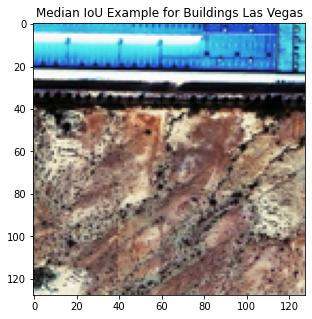

efficient_model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'dice_loss'}


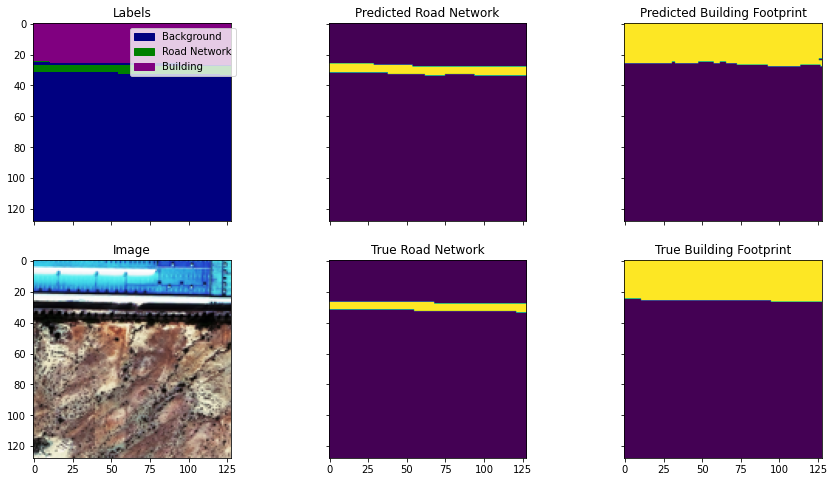

efficient_model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'BinaryCrossentropy'}


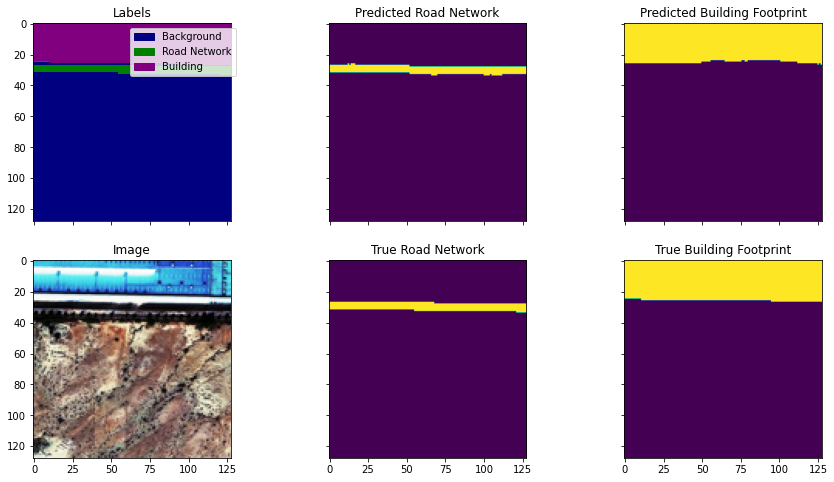

model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'dice_loss'}


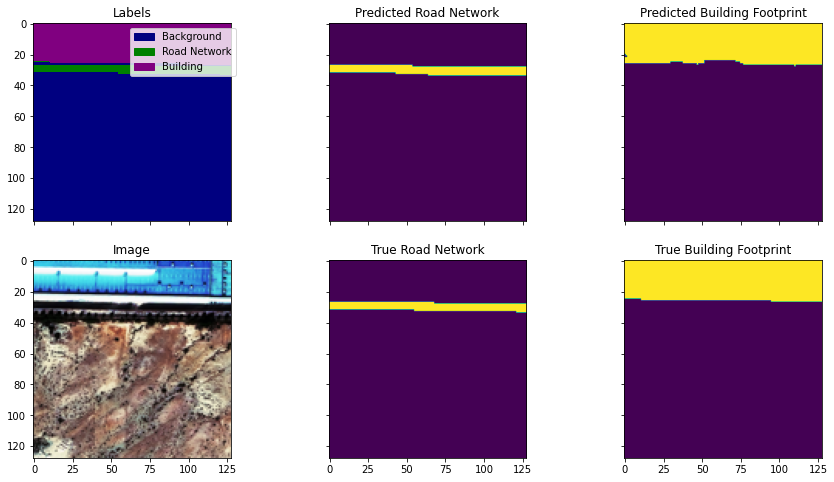

model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'BinaryCrossentropy'}


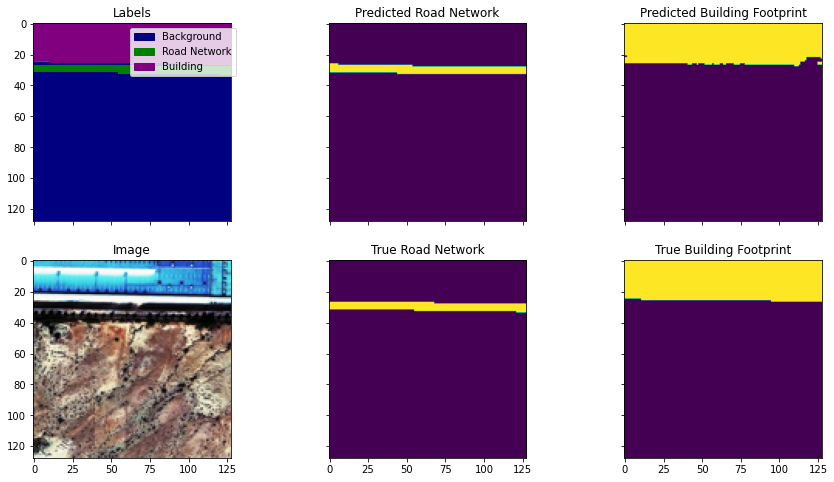

res_model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': True, 'loss': 'dice_loss'}


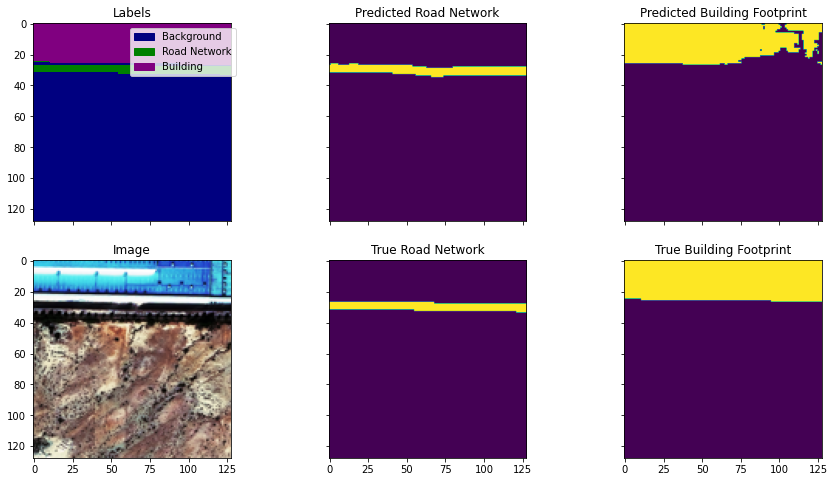

res_model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': True, 'loss': 'BinaryCrossentropy'}


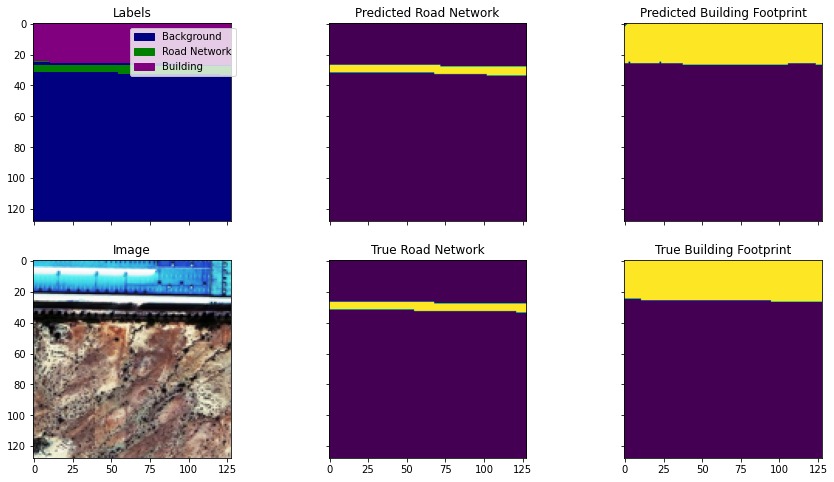

attention_model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'dice_loss'}


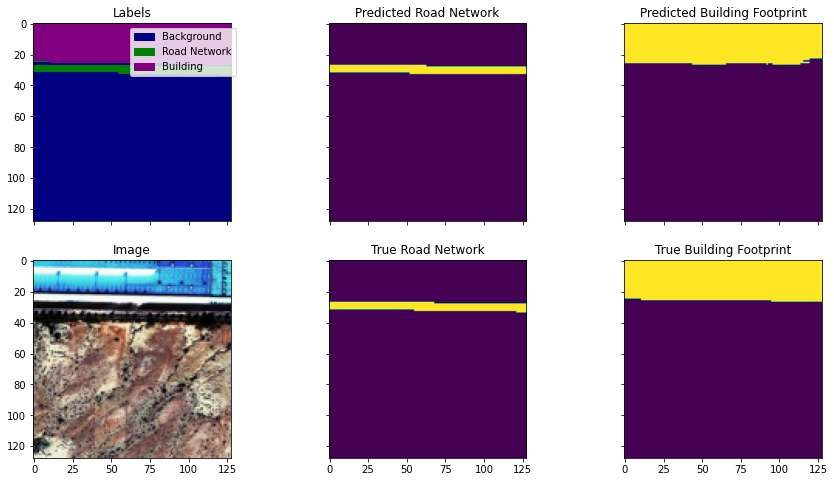

attention_model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'BinaryCrossentropy'}


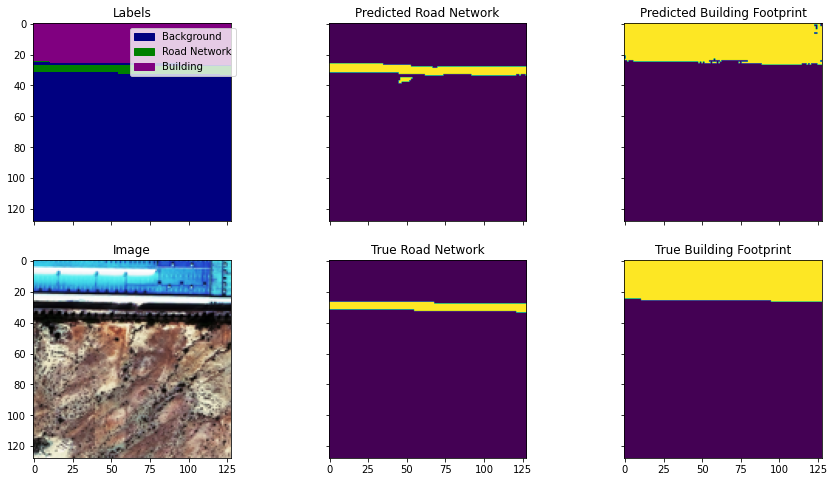

('..\\data_cleaning_EDA\\final_images_small\\SN3_roads_train_AOI_3_Paris_PS-RGB_img362_b.png', <Augment.UDFLIP: 3>)
('..\\data_cleaning_EDA\\final_masks_small\\SN3_roads_train_AOI_3_Paris_PS-RGB_img362_b.npy', <Augment.UDFLIP: 3>)


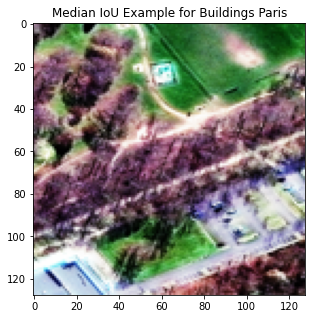

efficient_model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'dice_loss'}


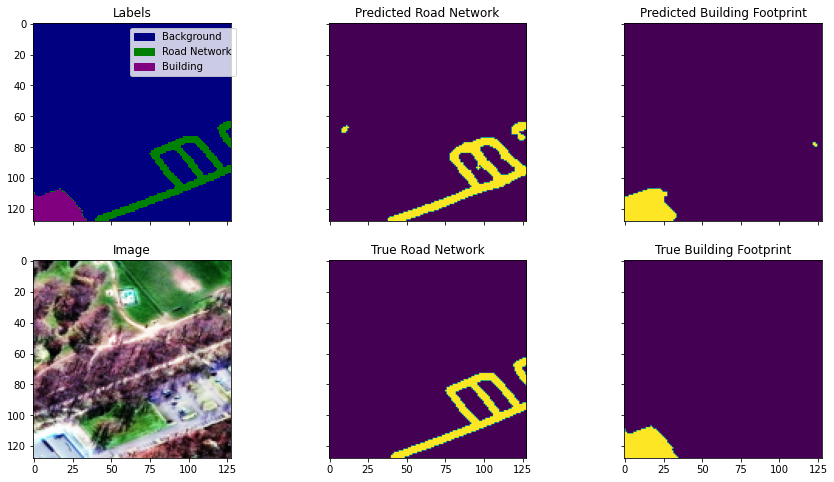

efficient_model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'BinaryCrossentropy'}


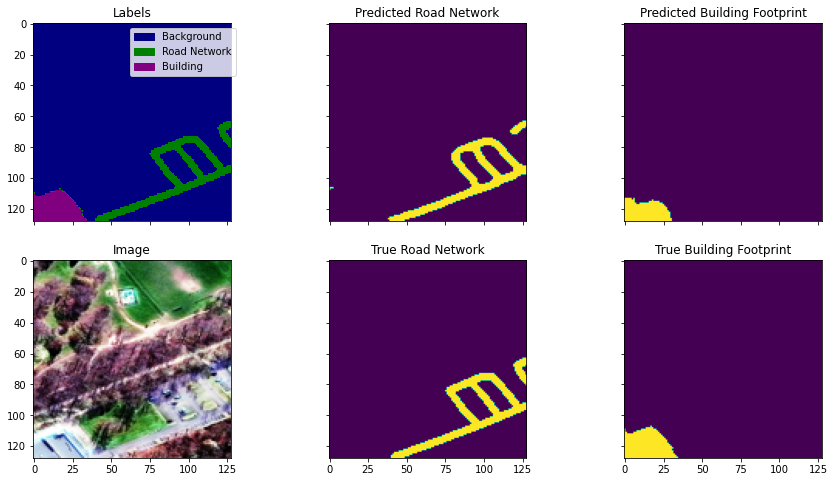

model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'dice_loss'}


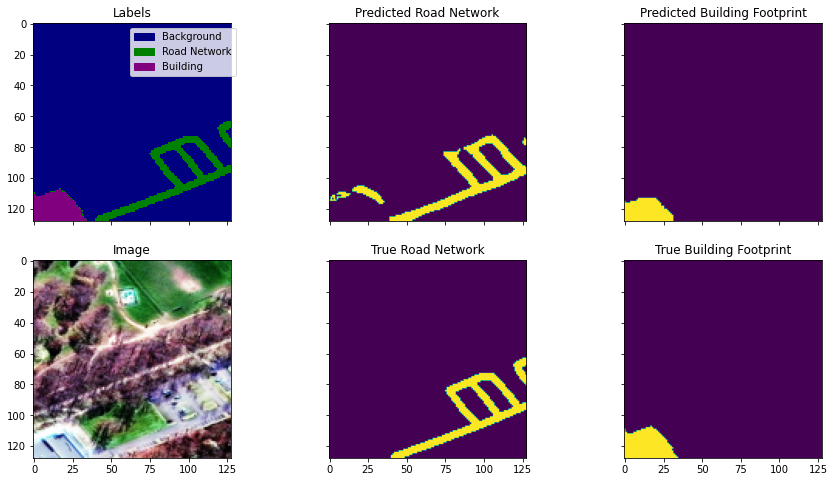

model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'BinaryCrossentropy'}


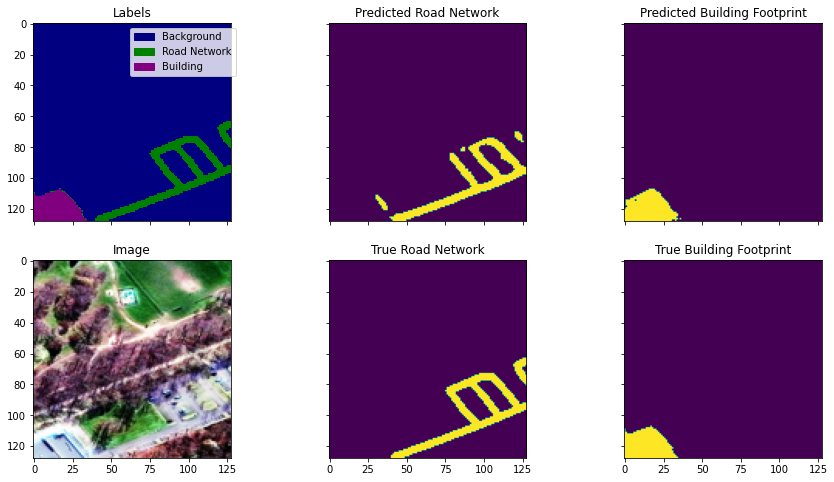

res_model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': True, 'loss': 'dice_loss'}


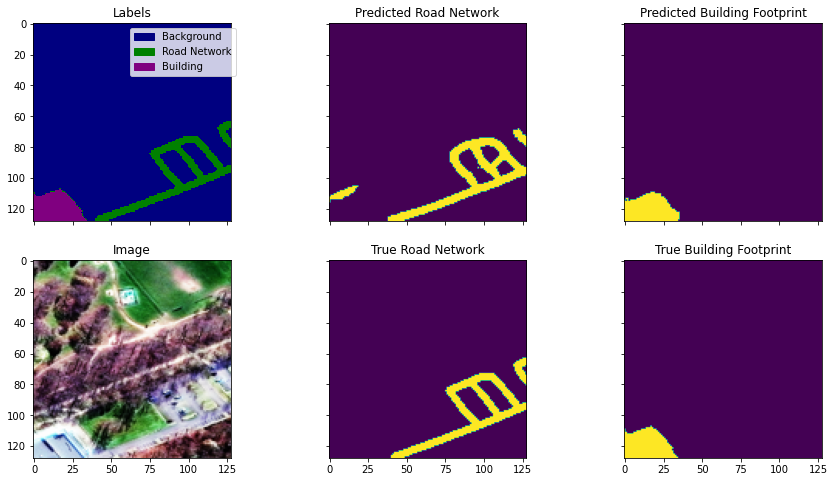

res_model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': True, 'loss': 'BinaryCrossentropy'}


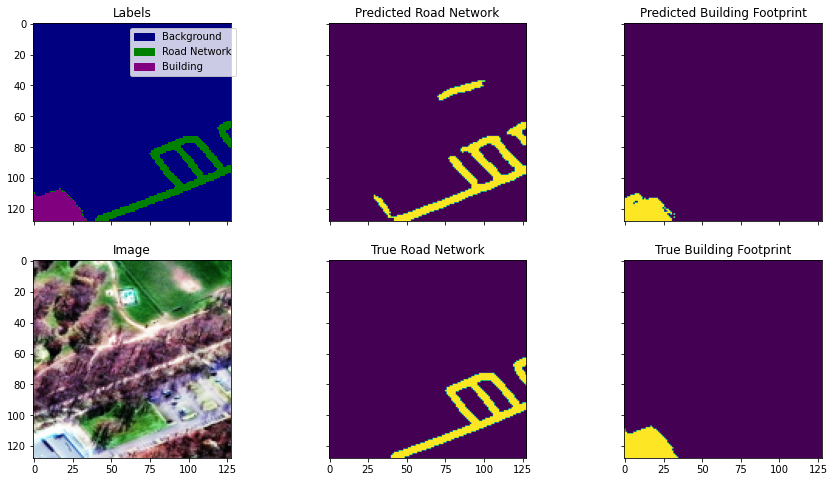

attention_model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'dice_loss'}


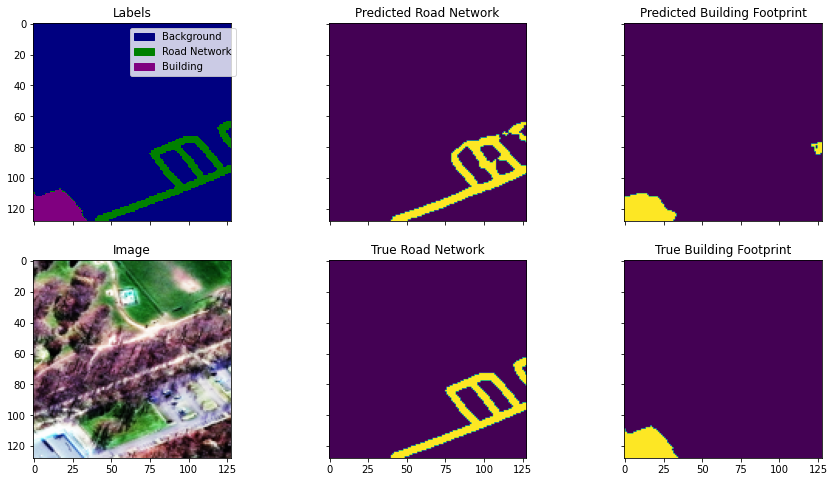

attention_model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'BinaryCrossentropy'}


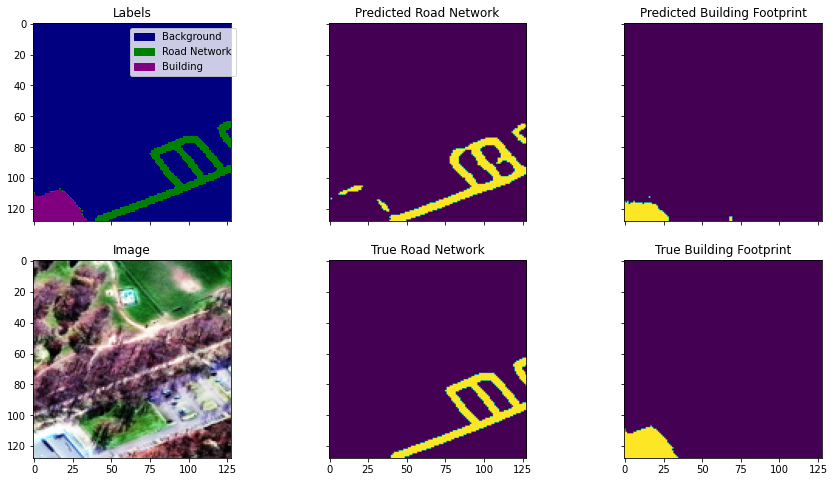

('..\\data_cleaning_EDA\\final_images_small\\SN3_roads_train_AOI_4_Shanghai_PS-RGB_img1939_b.png', <Augment.LRFLIP: 2>)
('..\\data_cleaning_EDA\\final_masks_small\\SN3_roads_train_AOI_4_Shanghai_PS-RGB_img1939_b.npy', <Augment.LRFLIP: 2>)


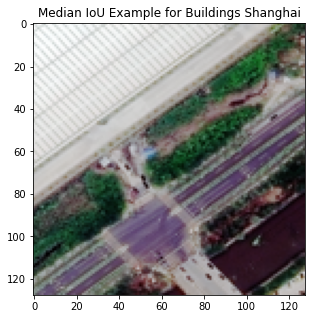

efficient_model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'dice_loss'}


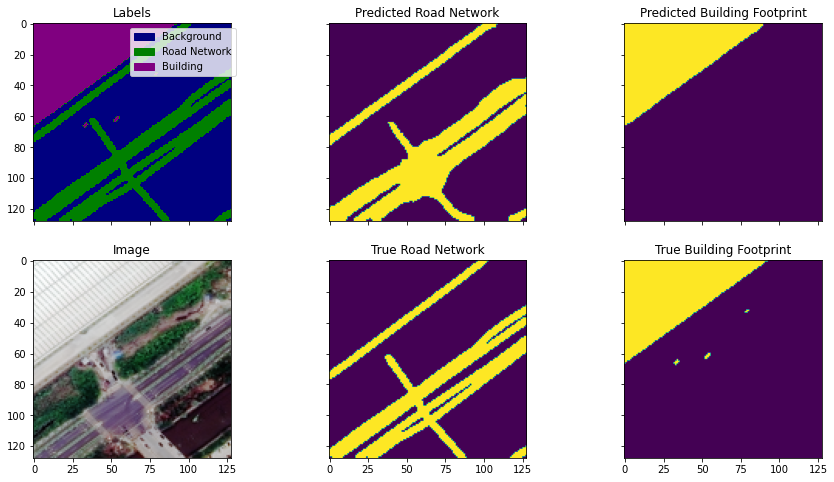

efficient_model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'BinaryCrossentropy'}


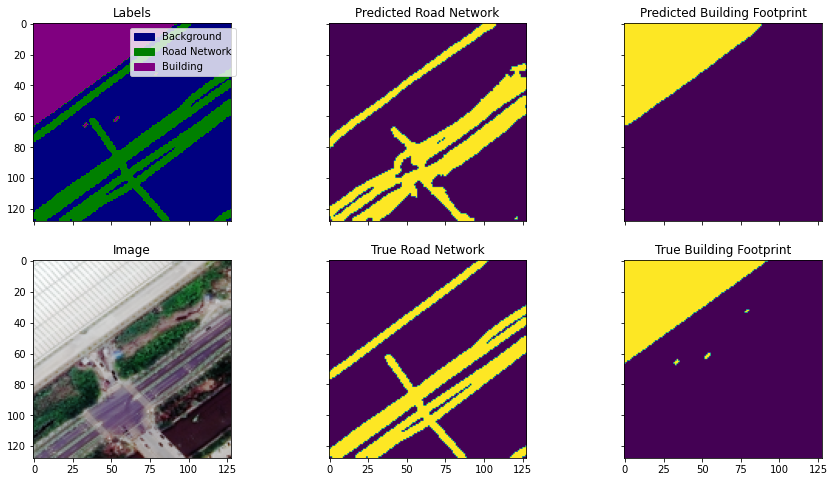

model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'dice_loss'}


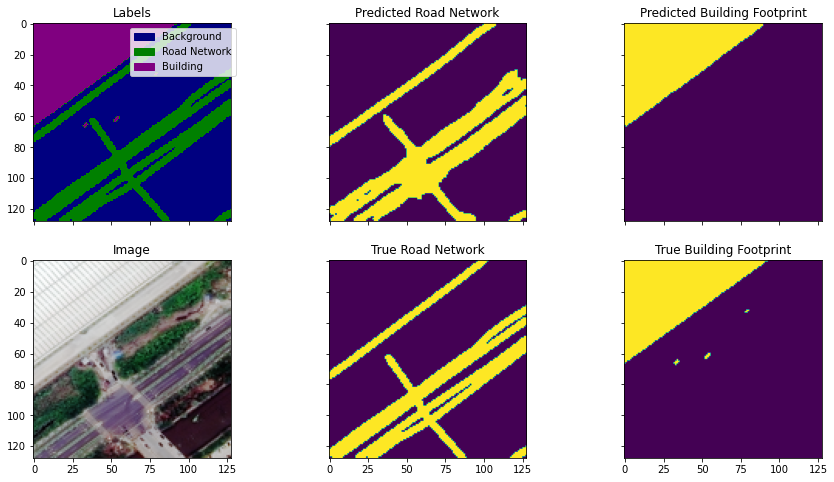

model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'BinaryCrossentropy'}


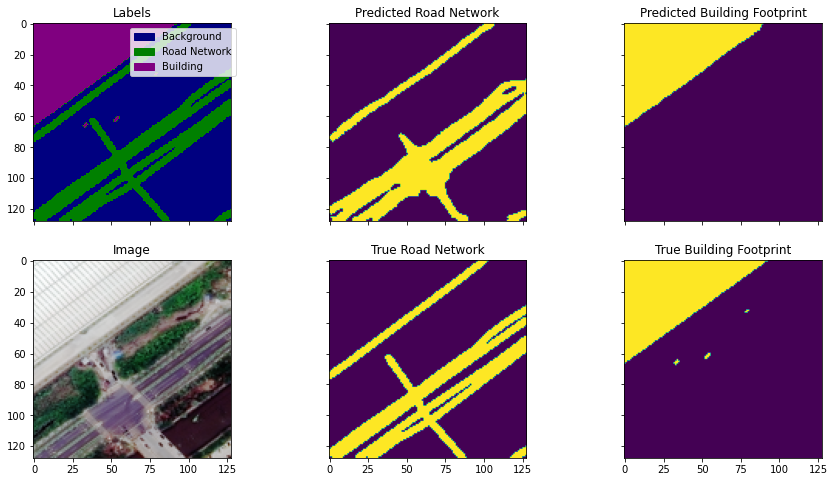

res_model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': True, 'loss': 'dice_loss'}


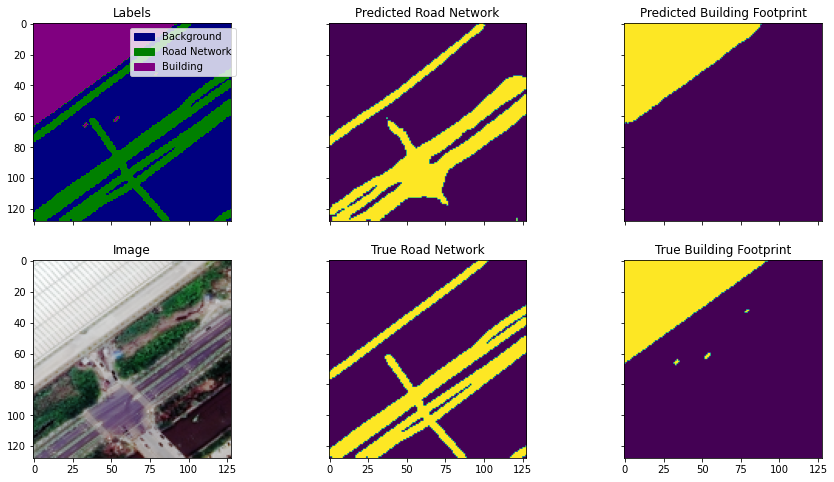

res_model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': True, 'loss': 'BinaryCrossentropy'}


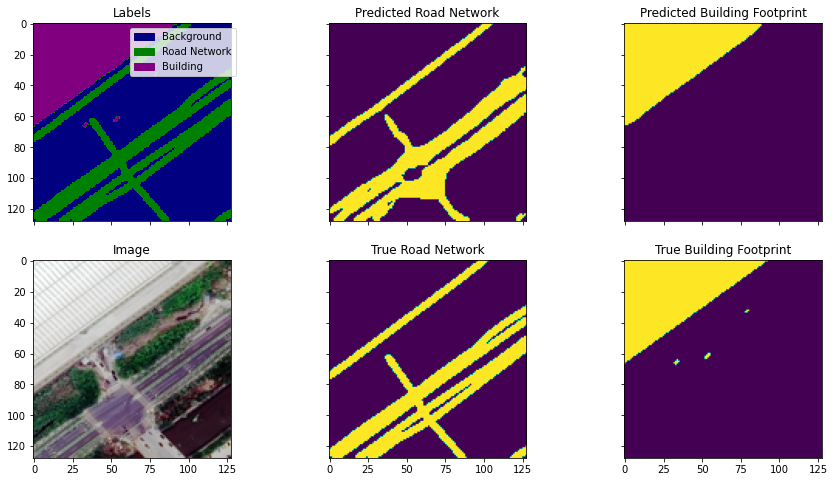

attention_model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'dice_loss'}


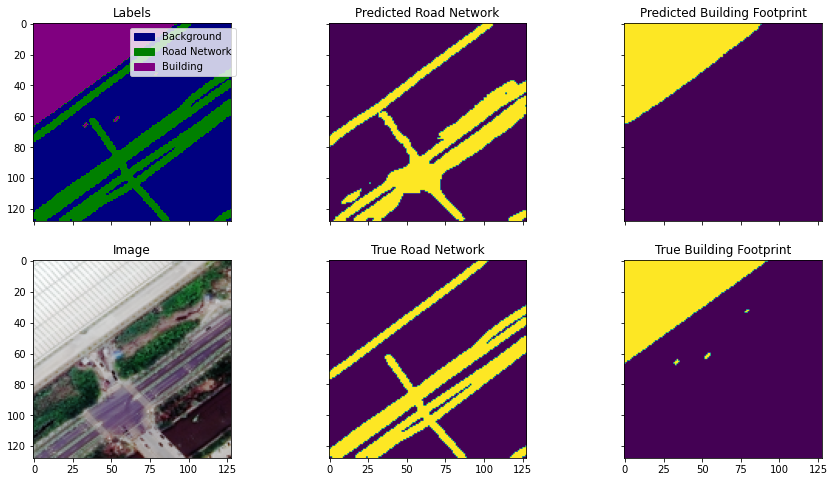

attention_model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'BinaryCrossentropy'}


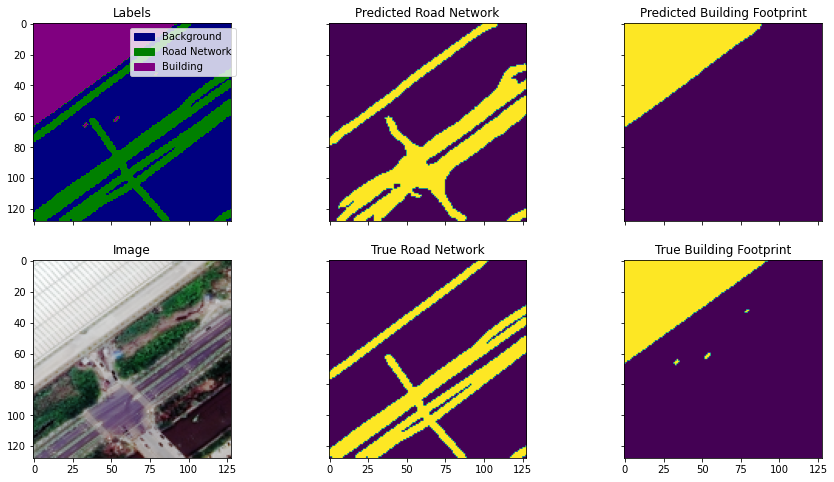

('..\\data_cleaning_EDA\\final_images_small\\AOI_5_Khartoum_img431.png', <Augment.LRFLIP: 2>)
('..\\data_cleaning_EDA\\final_masks_small\\AOI_5_Khartoum_img431.npy', <Augment.LRFLIP: 2>)


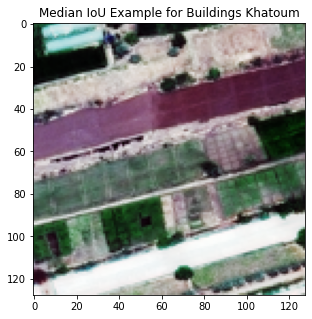

efficient_model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'dice_loss'}


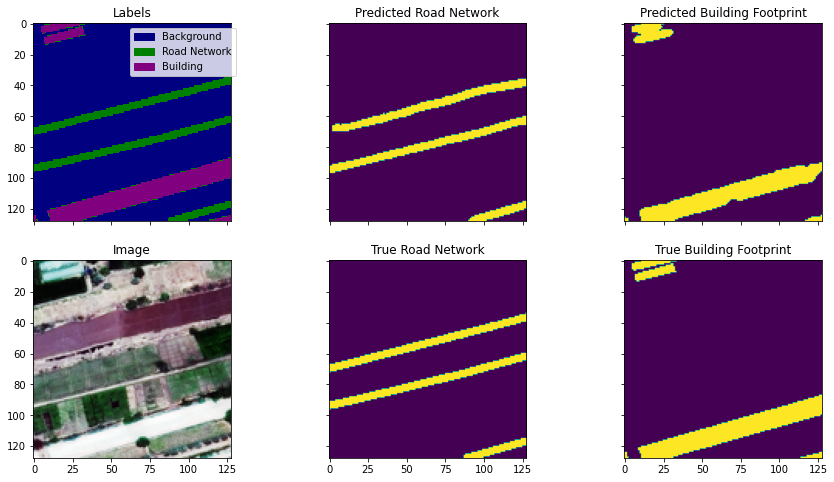

efficient_model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'BinaryCrossentropy'}


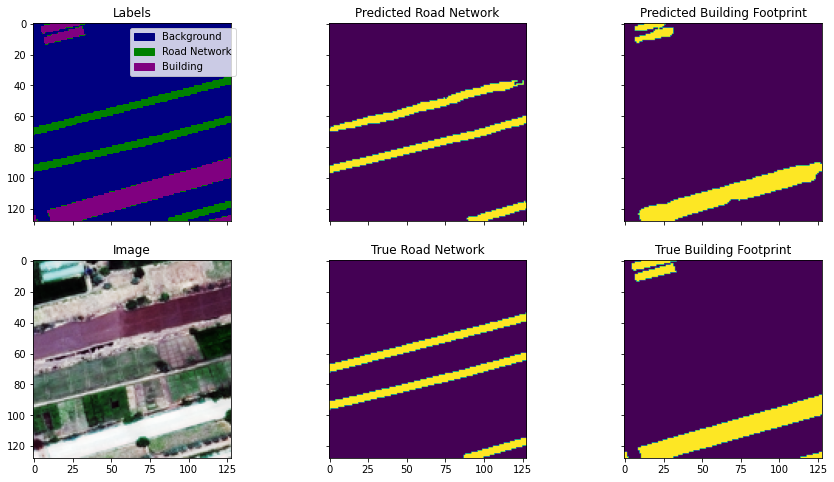

model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'dice_loss'}


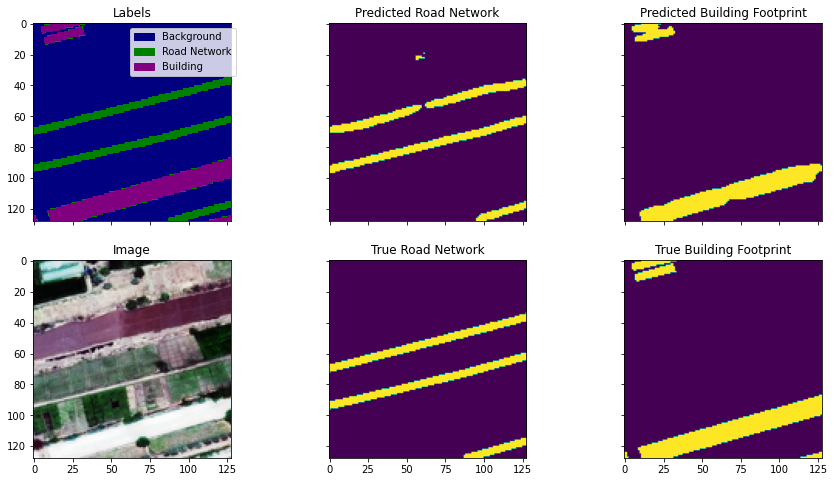

model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'BinaryCrossentropy'}


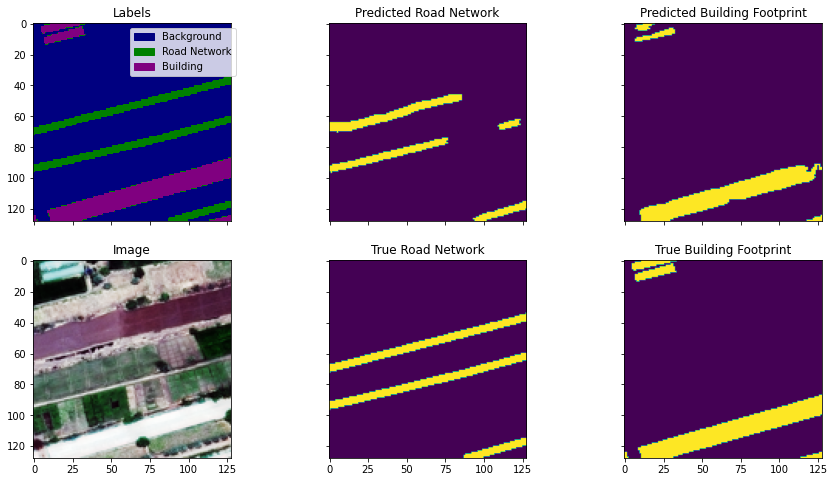

res_model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': True, 'loss': 'dice_loss'}


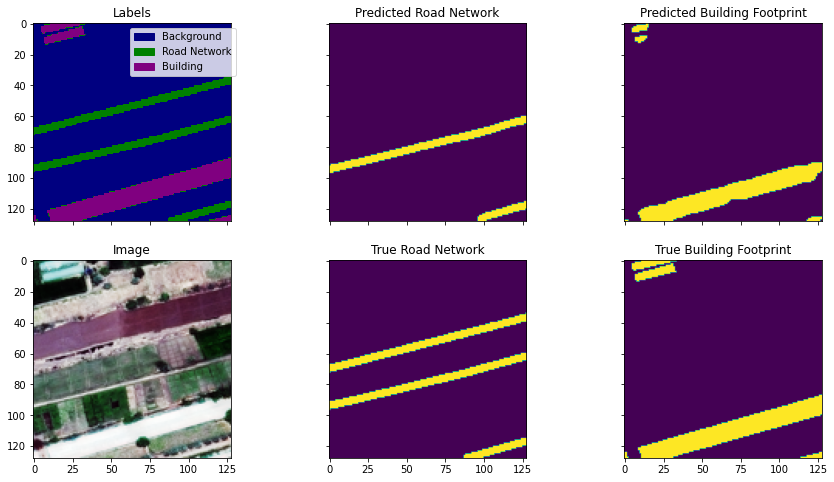

res_model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': True, 'loss': 'BinaryCrossentropy'}


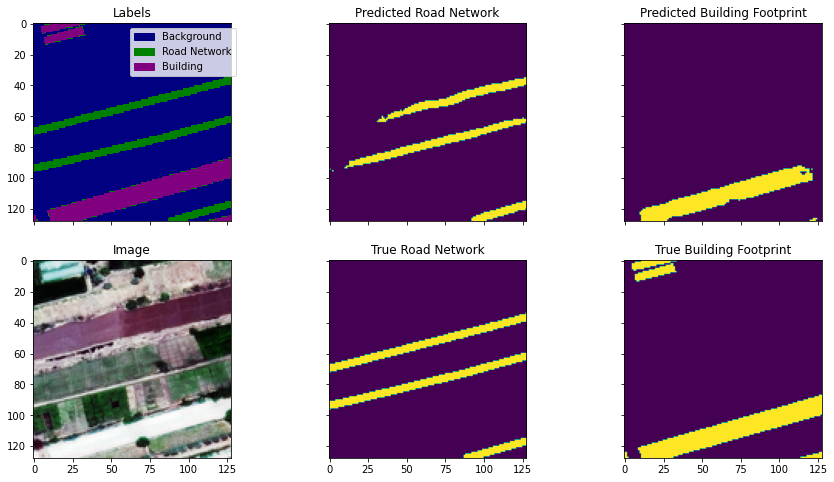

attention_model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'dice_loss'}


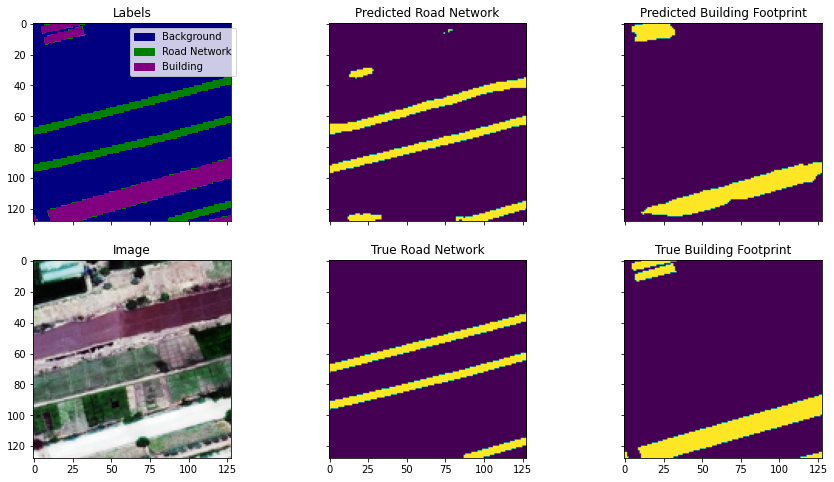

attention_model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'BinaryCrossentropy'}


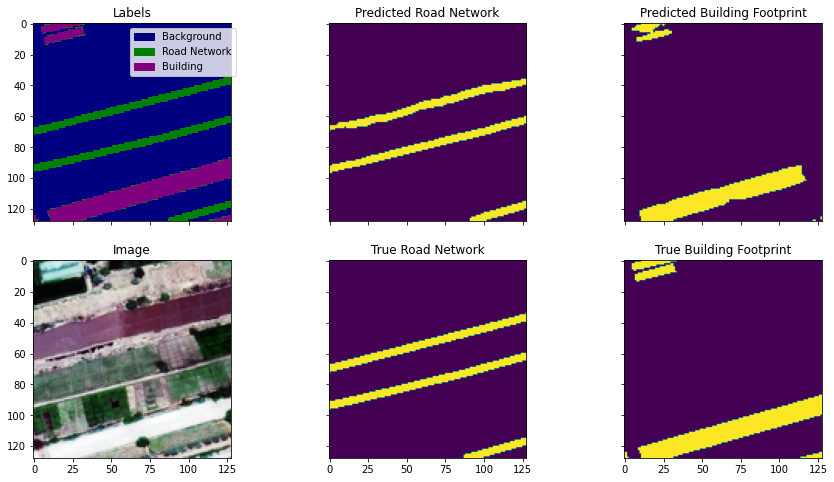

In [20]:
for g, aoi in enumerate(["Las Vegas", "Paris", "Shanghai", "Khatoum"]):
    k= best_building_index[g]

    batch = math.floor(k / test_data.batch_size) 
    index = k - batch * test_data.batch_size
    print(test_data.x[k])
    print(test_data.y[k])
    X_test_batch, y_test_batch = test_data.__getitem__(batch)
    plt.figure(figsize=(5, 5))
    plt.title(f'Median IoU Example for Buildings {aoi}')
    plt.imshow(X_test_batch[index, :, :])
    plt.show()
    for model_name, model_config in model_configurations.items():
        print(model_name, model_config)
        if os.path.exists(model_name):
            plot_result(X_test_batch, y_test_batch, model_name=model_name, display_prob=False, index=index)
            plt.show()

# Median IoU Example road extraction for each area of interest

('..\\data_cleaning_EDA\\final_images_small\\AOI_2_Vegas_img2338.png', <Augment.ROT90: 4>)
('..\\data_cleaning_EDA\\final_masks_small\\AOI_2_Vegas_img2338.npy', <Augment.ROT90: 4>)


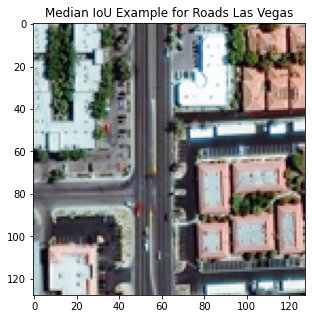

efficient_model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'dice_loss'}


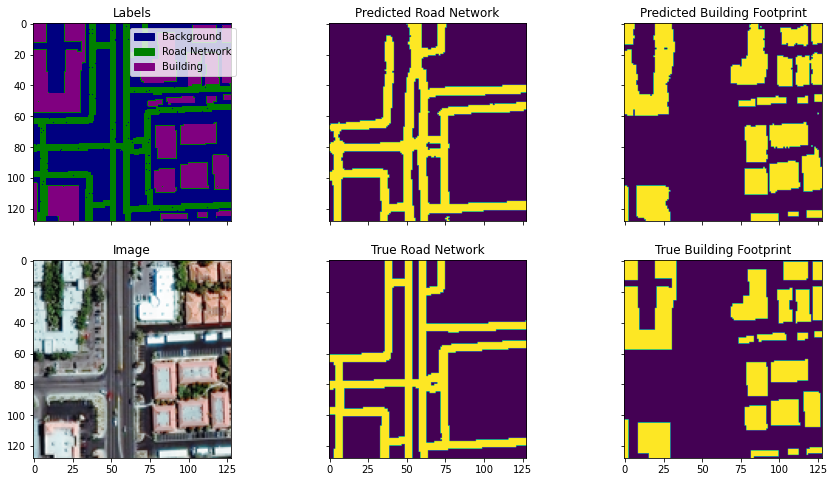

efficient_model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'BinaryCrossentropy'}


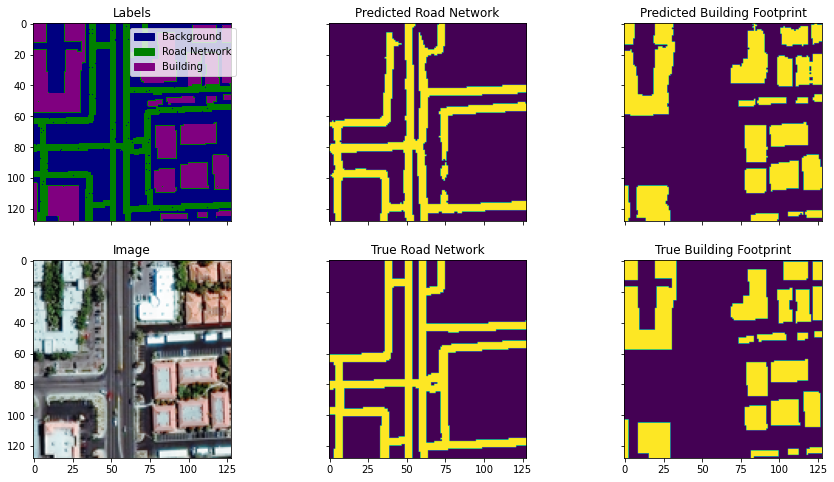

model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'dice_loss'}


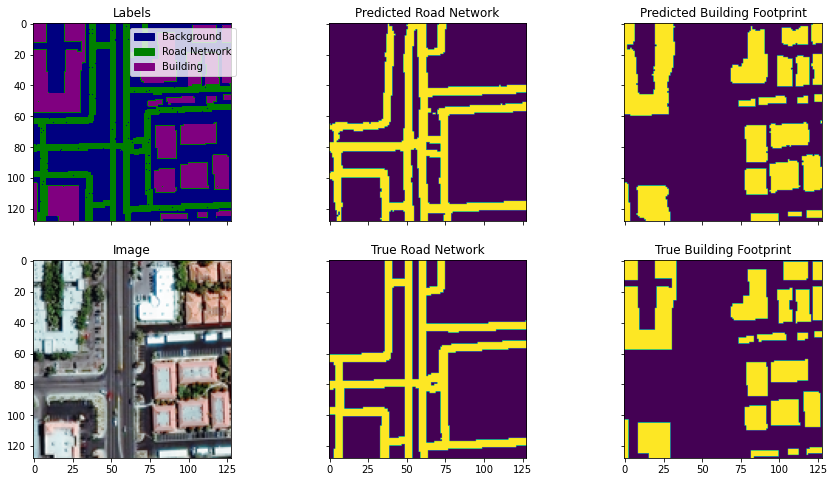

model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'BinaryCrossentropy'}


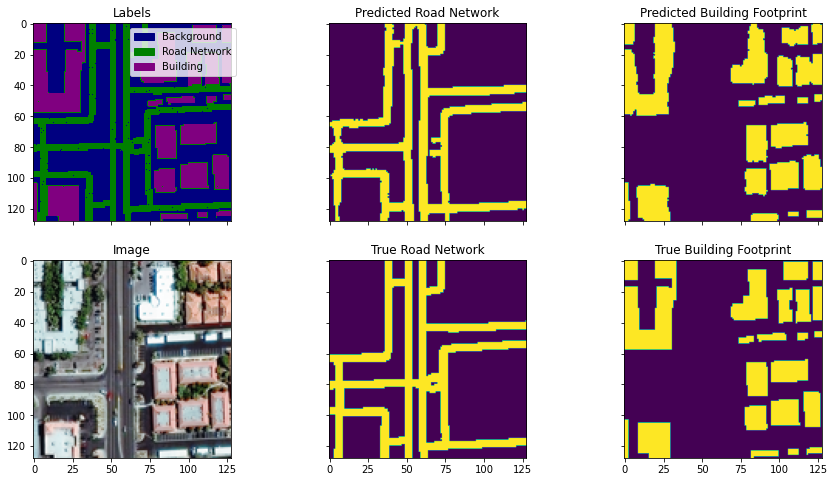

res_model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': True, 'loss': 'dice_loss'}


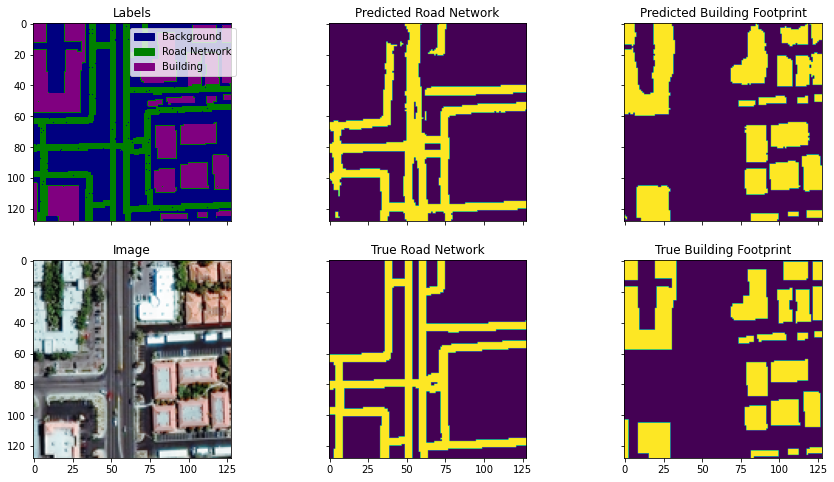

res_model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': True, 'loss': 'BinaryCrossentropy'}


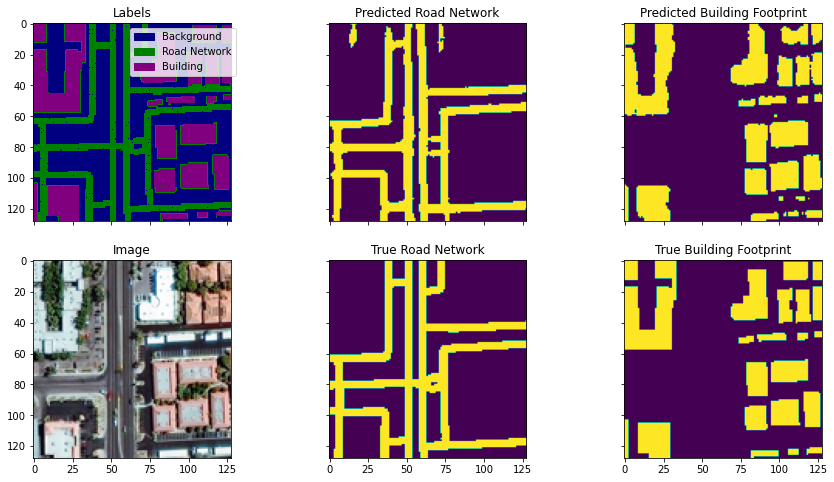

attention_model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'dice_loss'}


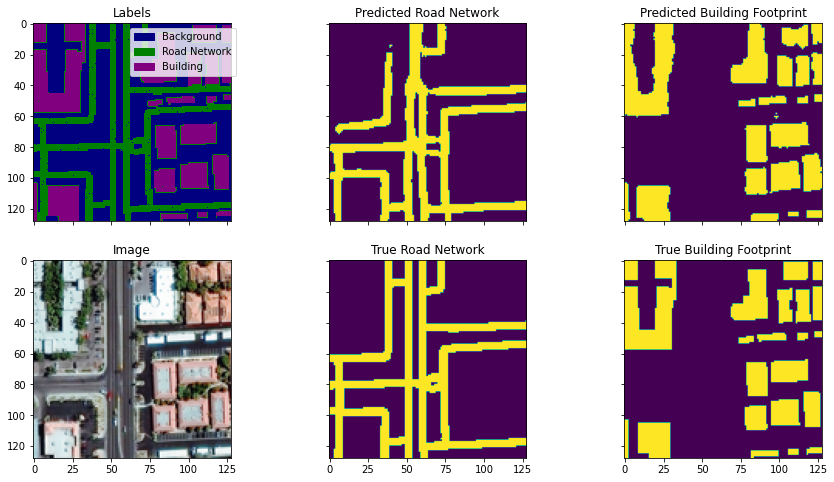

attention_model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'BinaryCrossentropy'}


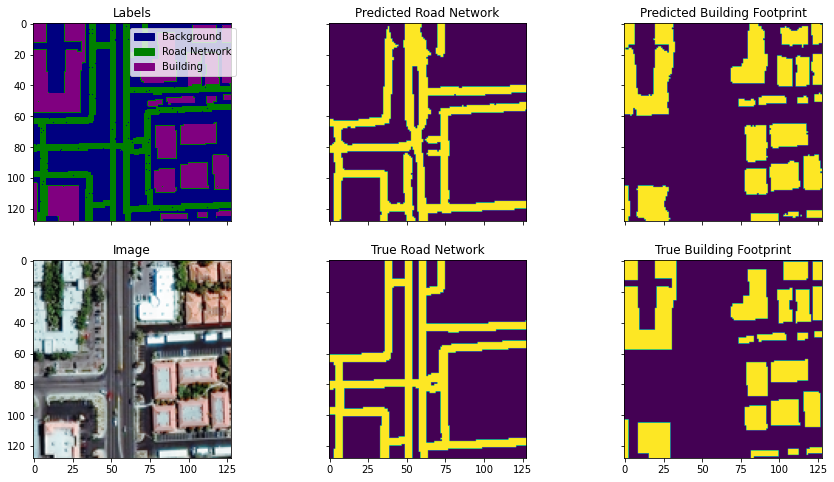

('..\\data_cleaning_EDA\\final_images_small\\AOI_3_Paris_img1354.png', <Augment.LRFLIP: 2>)
('..\\data_cleaning_EDA\\final_masks_small\\AOI_3_Paris_img1354.npy', <Augment.LRFLIP: 2>)


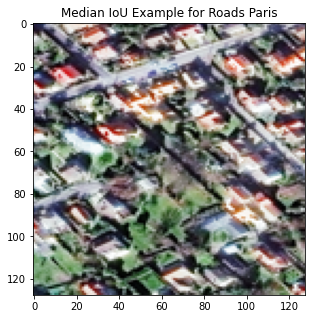

efficient_model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'dice_loss'}


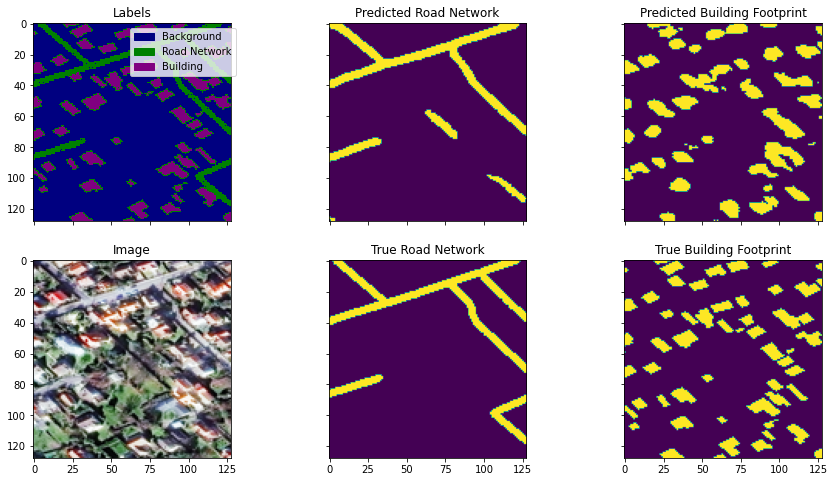

efficient_model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'BinaryCrossentropy'}


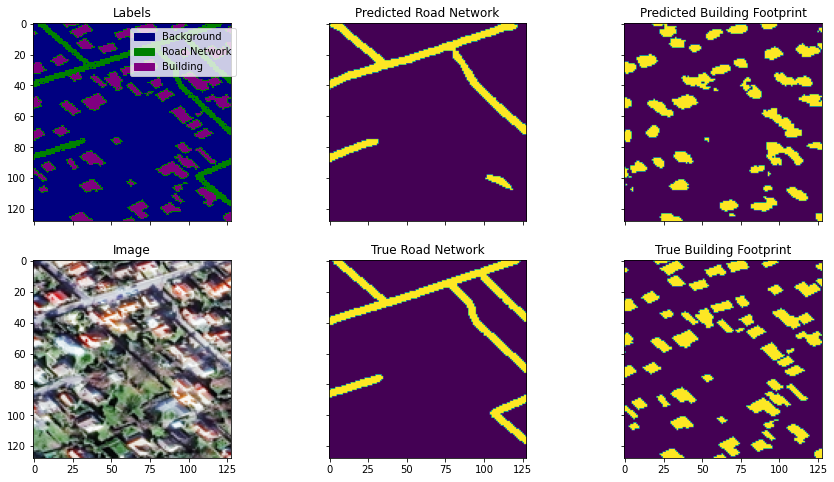

model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'dice_loss'}


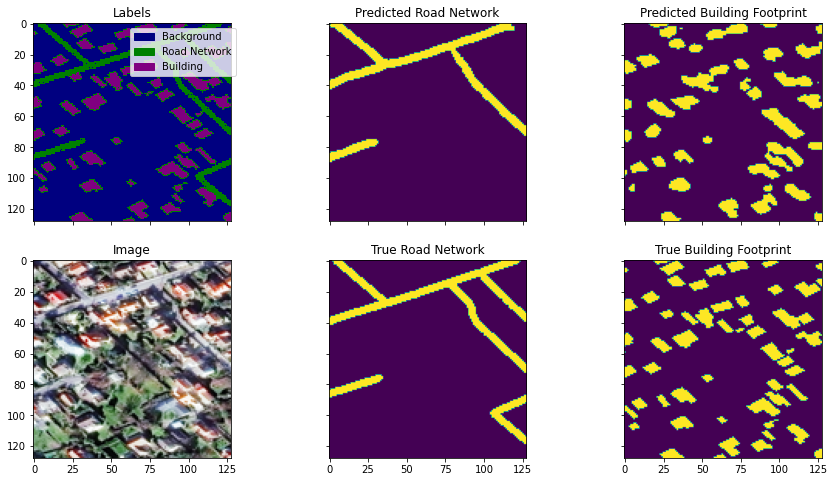

model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'BinaryCrossentropy'}


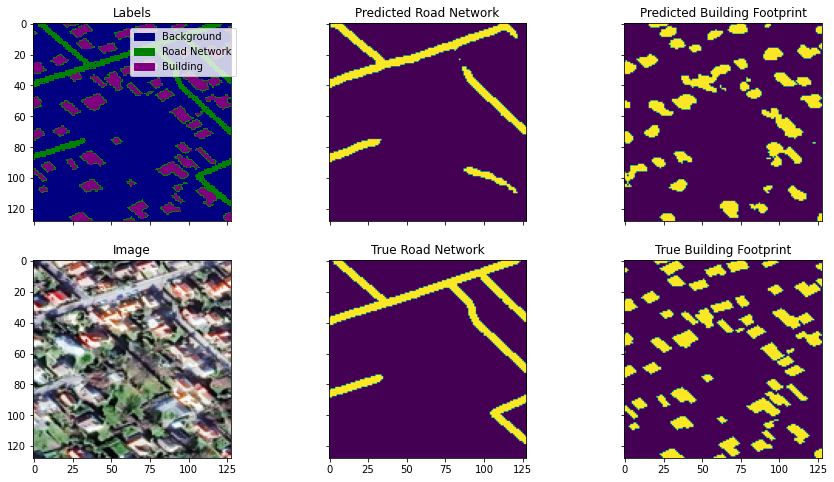

res_model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': True, 'loss': 'dice_loss'}


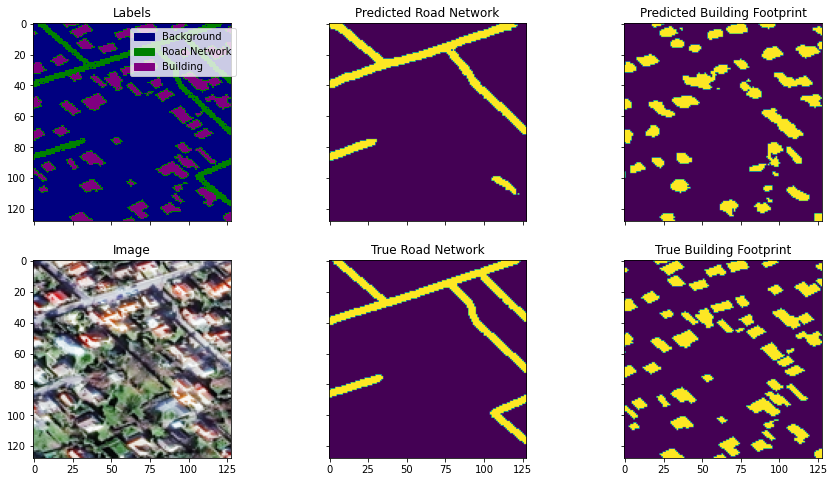

res_model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': True, 'loss': 'BinaryCrossentropy'}


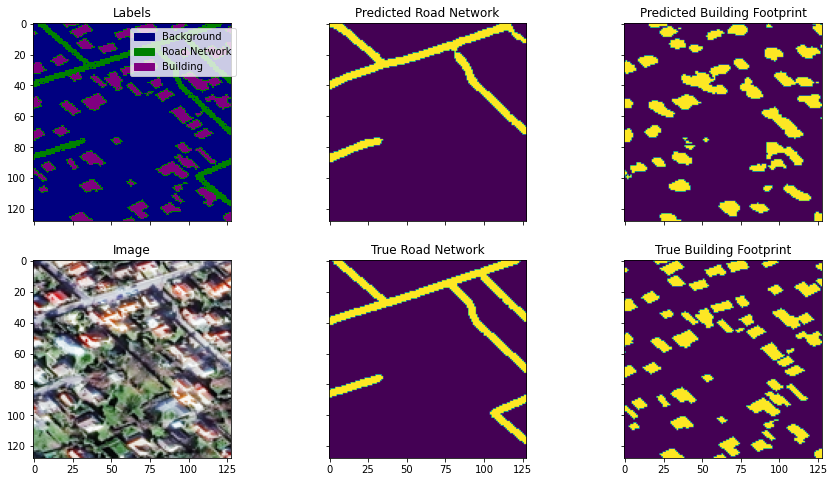

attention_model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'dice_loss'}


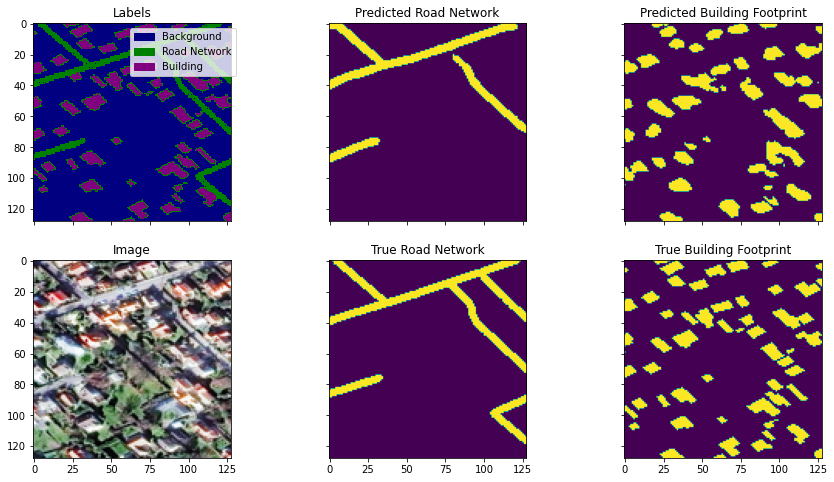

attention_model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'BinaryCrossentropy'}


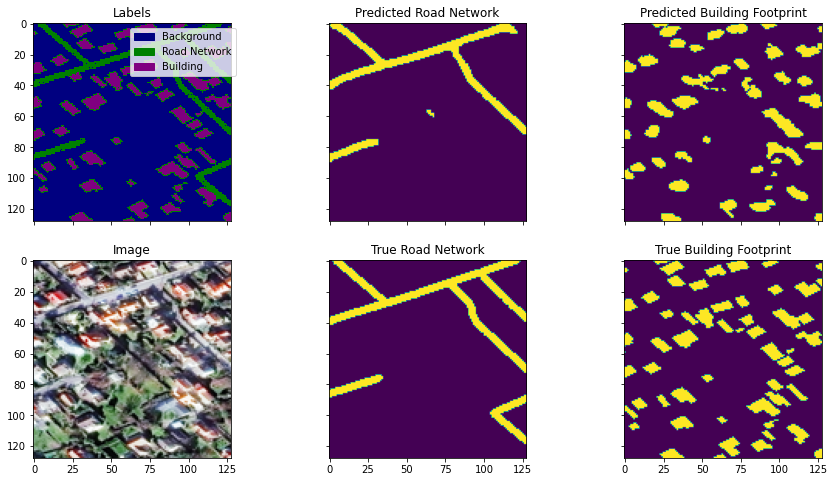

('..\\data_cleaning_EDA\\final_images_small\\AOI_4_Shanghai_img1699.png', <Augment.ROT270: 5>)
('..\\data_cleaning_EDA\\final_masks_small\\AOI_4_Shanghai_img1699.npy', <Augment.ROT270: 5>)


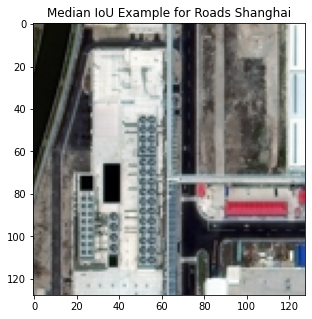

efficient_model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'dice_loss'}


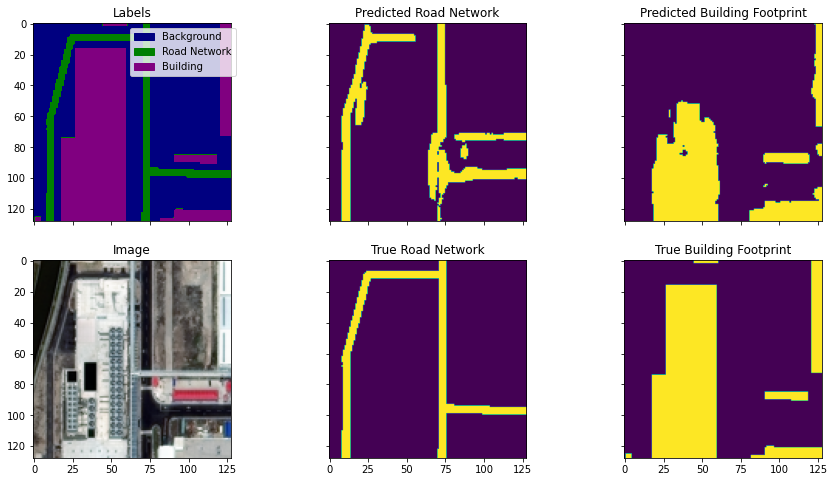

efficient_model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'BinaryCrossentropy'}


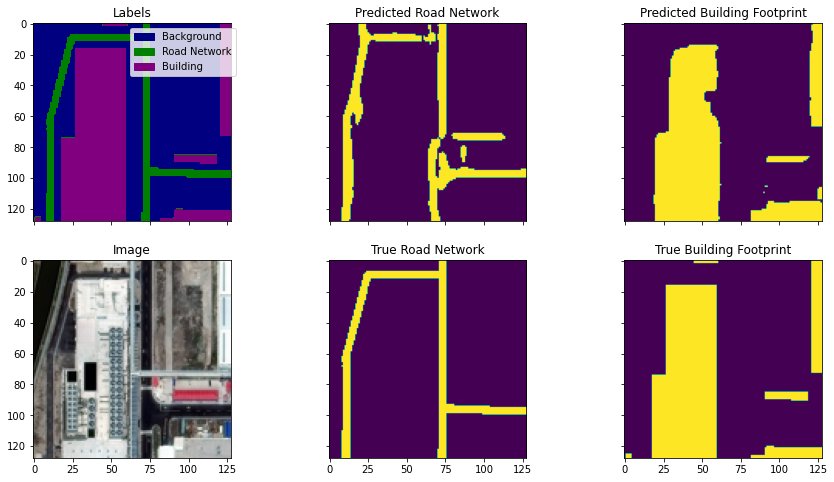

model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'dice_loss'}


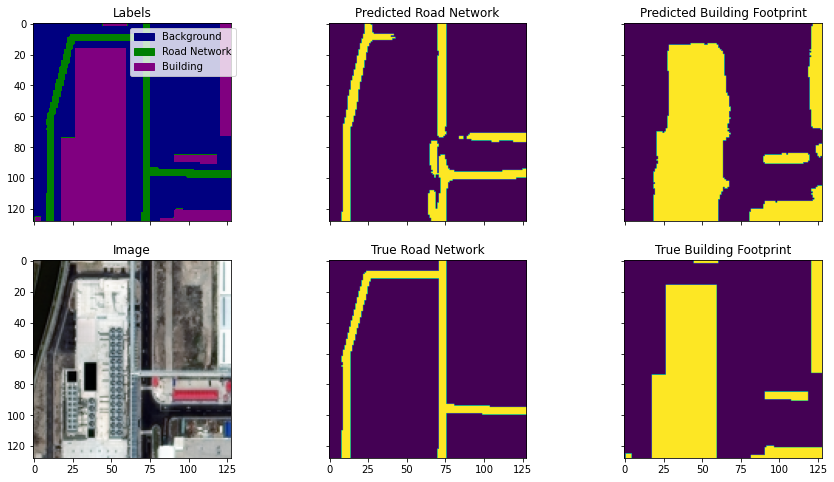

model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'BinaryCrossentropy'}


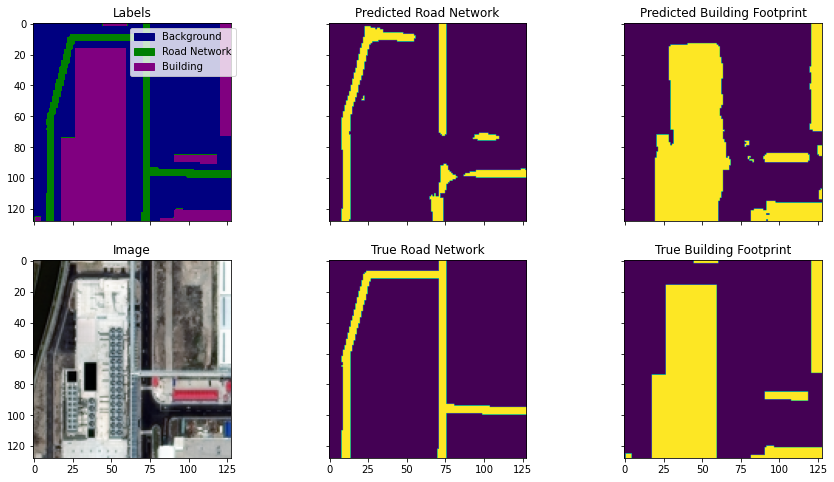

res_model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': True, 'loss': 'dice_loss'}


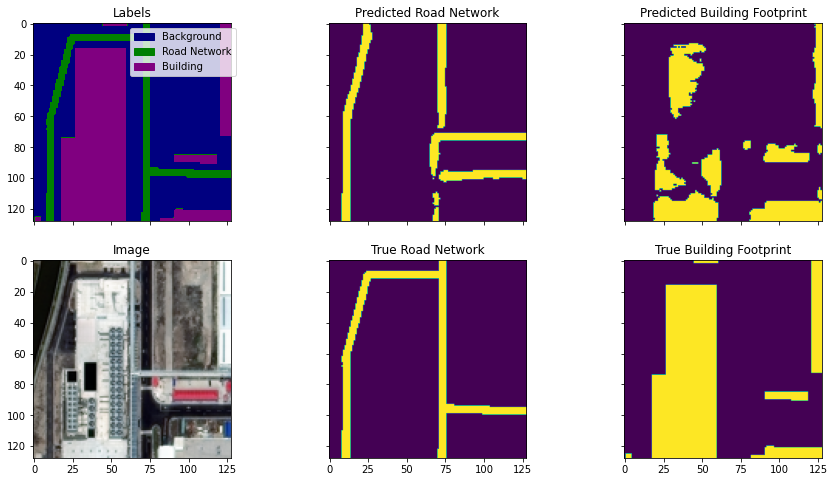

res_model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': True, 'loss': 'BinaryCrossentropy'}


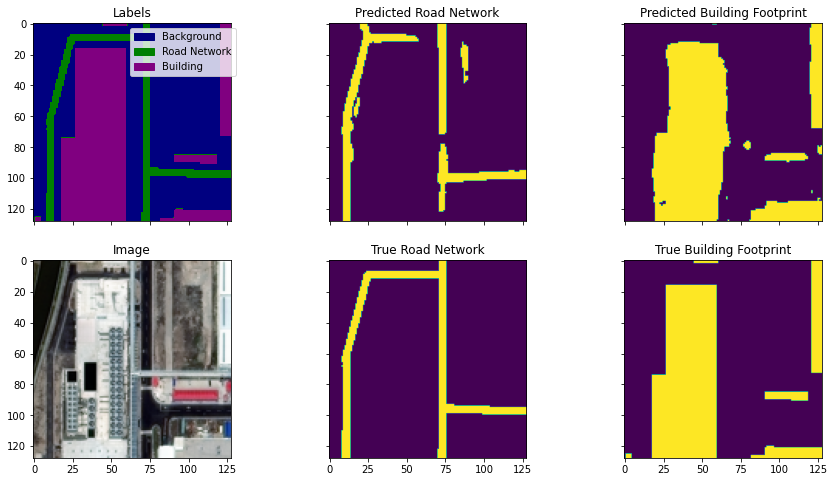

attention_model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'dice_loss'}


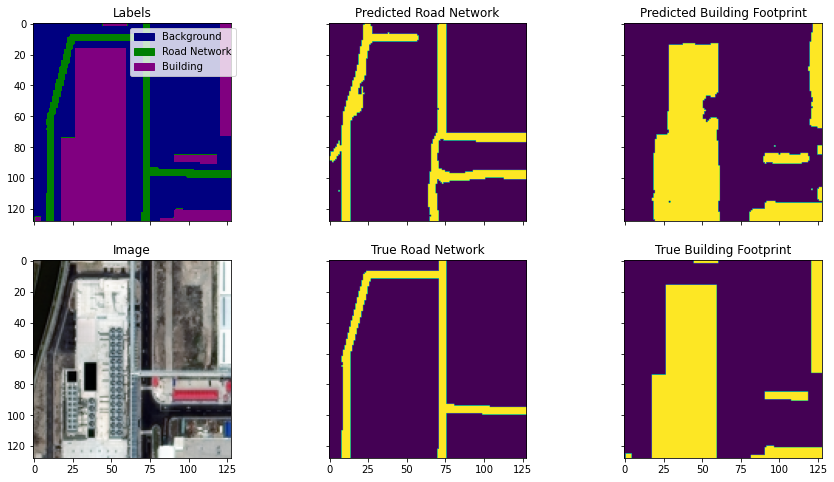

attention_model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'BinaryCrossentropy'}


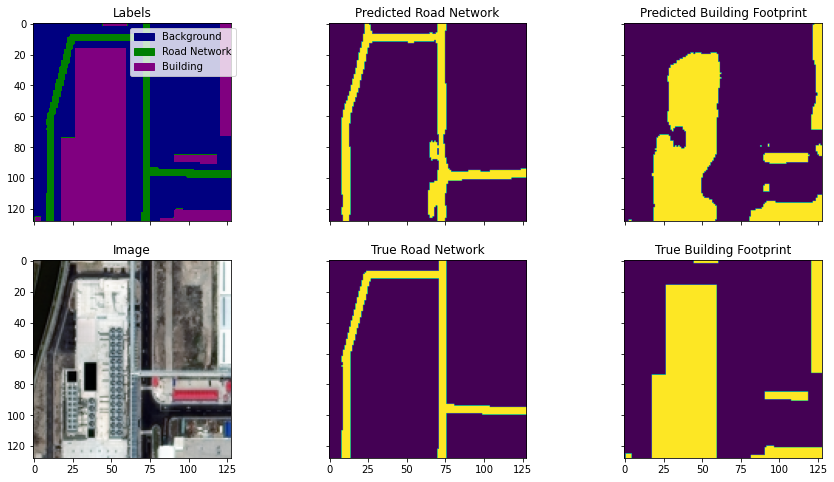

('..\\data_cleaning_EDA\\final_images_small\\SN3_roads_train_AOI_5_Khartoum_PS-RGB_img442_b.png', <Augment.ORIGINAL: 1>)
('..\\data_cleaning_EDA\\final_masks_small\\SN3_roads_train_AOI_5_Khartoum_PS-RGB_img442_b.npy', <Augment.ORIGINAL: 1>)


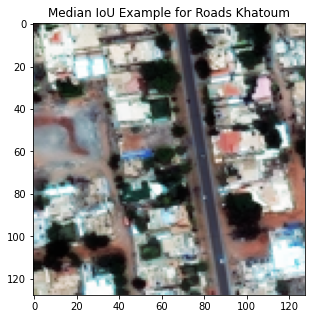

efficient_model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'dice_loss'}


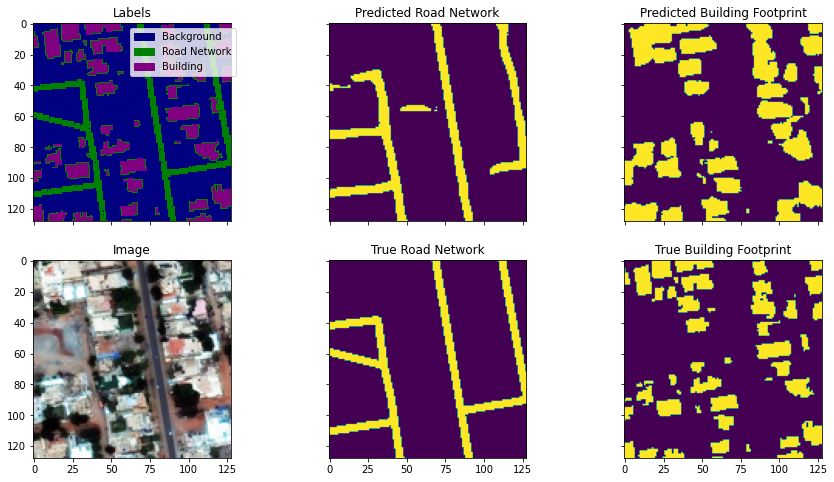

efficient_model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'BinaryCrossentropy'}


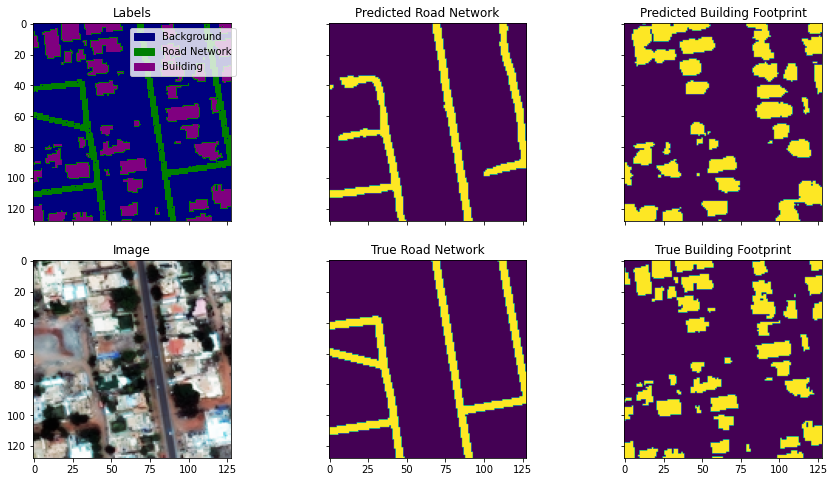

model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'dice_loss'}


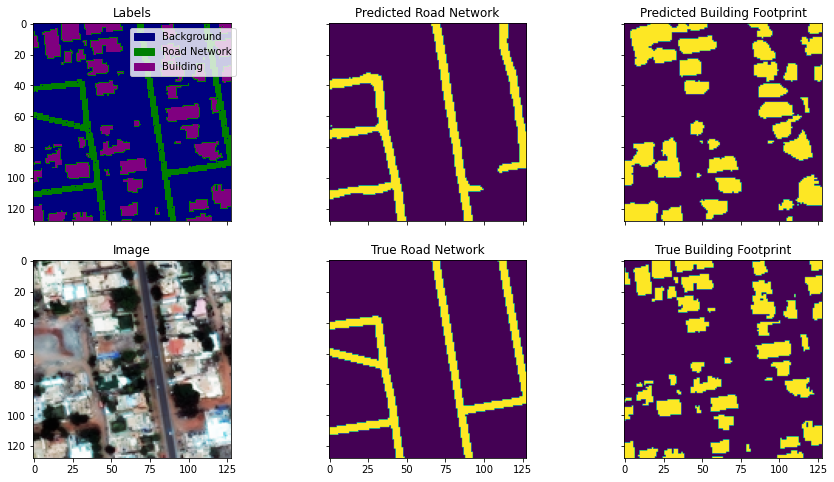

model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'BinaryCrossentropy'}


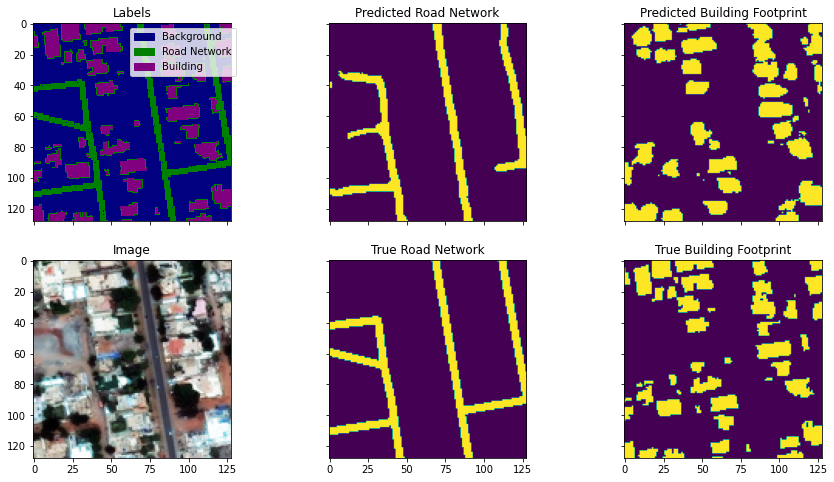

res_model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': True, 'loss': 'dice_loss'}


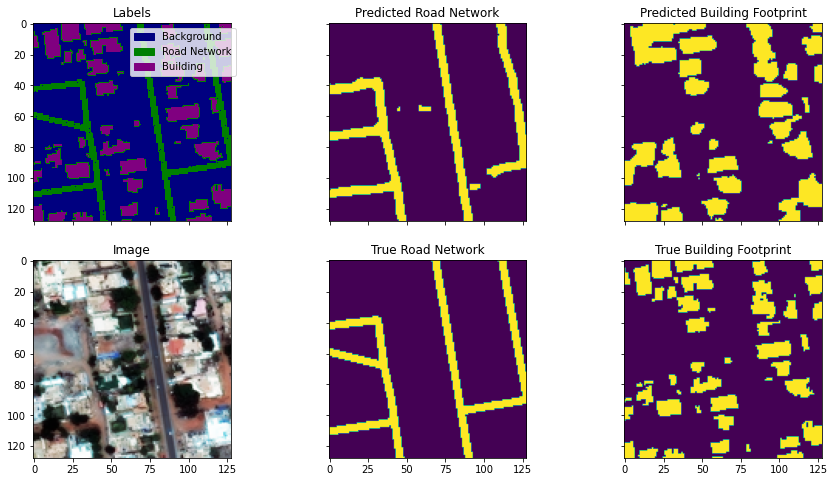

res_model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': True, 'loss': 'BinaryCrossentropy'}


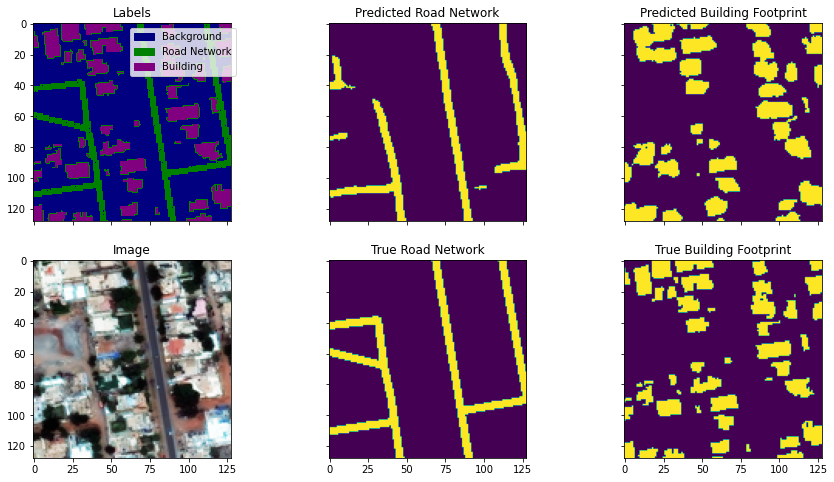

attention_model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'dice_loss'}


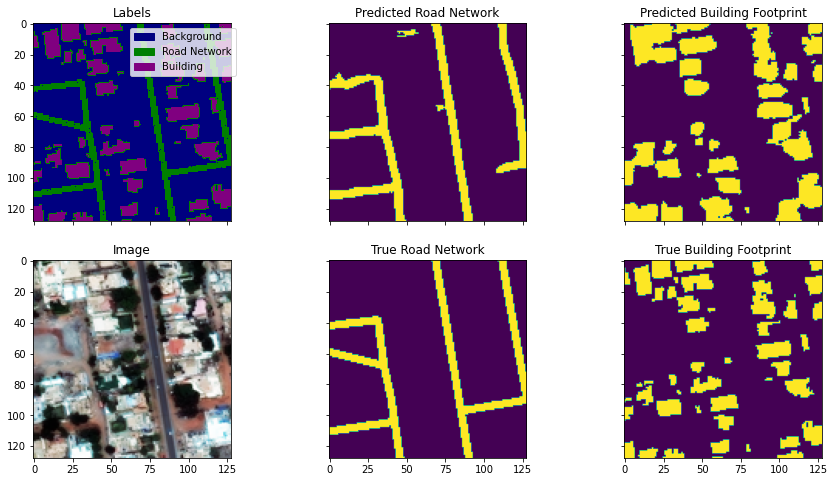

attention_model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'BinaryCrossentropy'}


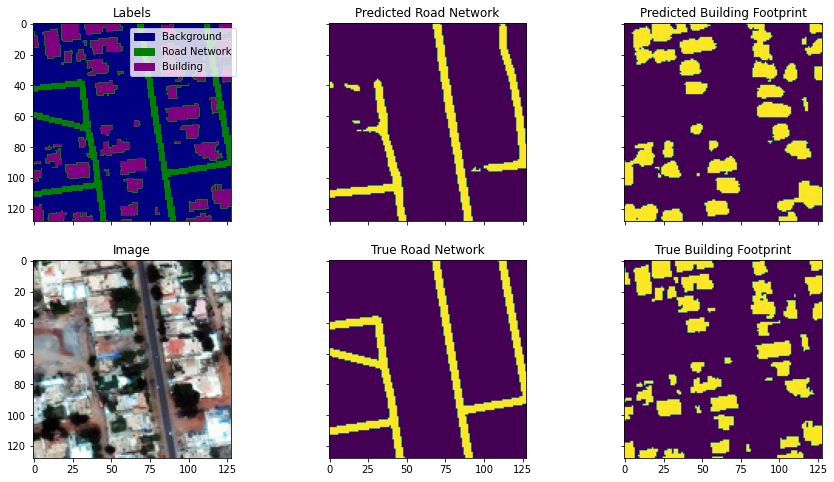

In [21]:
for g, aoi in enumerate(["Las Vegas", "Paris", "Shanghai", "Khatoum"]):
    k= median_road_index[g]

    batch = math.floor(k / test_data.batch_size) 
    index = k - batch * test_data.batch_size
    print(test_data.x[k])
    print(test_data.y[k])
    X_test_batch, y_test_batch = test_data.__getitem__(batch)
    plt.figure(figsize=(5, 5))
    plt.title(f'Median IoU Example for Roads {aoi}')
    plt.imshow(X_test_batch[index, :, :])
    plt.show()
    for model_name, model_config in model_configurations.items():
        print(model_name, model_config)
        if os.path.exists(model_name):
            plot_result(X_test_batch, y_test_batch, model_name=model_name, display_prob=False, index=index)
            plt.show()

# Best IoU Example road extraction for each area of interest

('..\\data_cleaning_EDA\\final_images_small\\SN3_roads_train_AOI_2_Vegas_PS-RGB_img1427_c.png', <Augment.ROT90: 4>)
('..\\data_cleaning_EDA\\final_masks_small\\SN3_roads_train_AOI_2_Vegas_PS-RGB_img1427_c.npy', <Augment.ROT90: 4>)


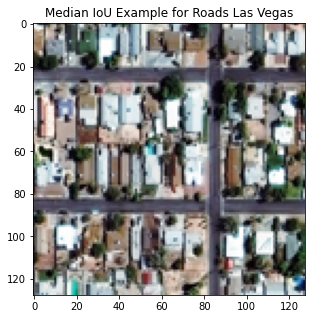

efficient_model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'dice_loss'}


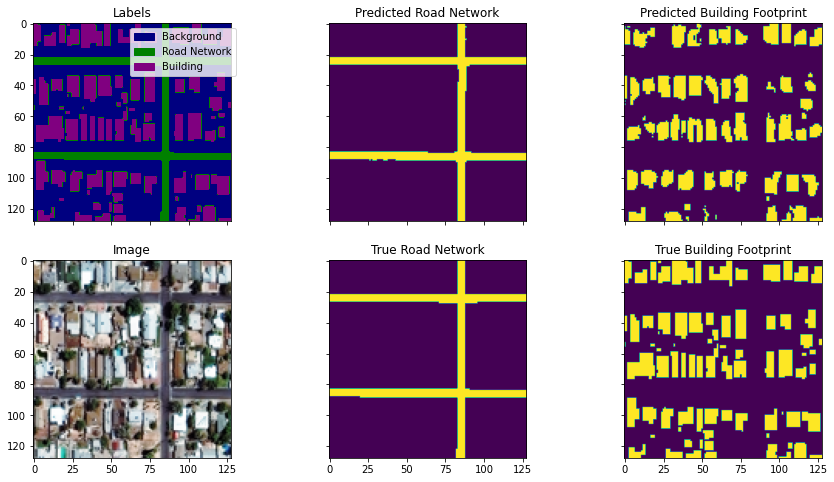

efficient_model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'BinaryCrossentropy'}


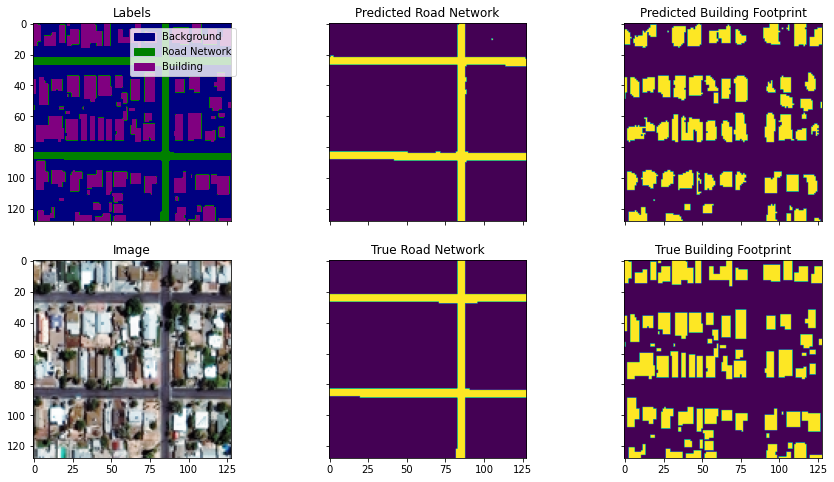

model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'dice_loss'}


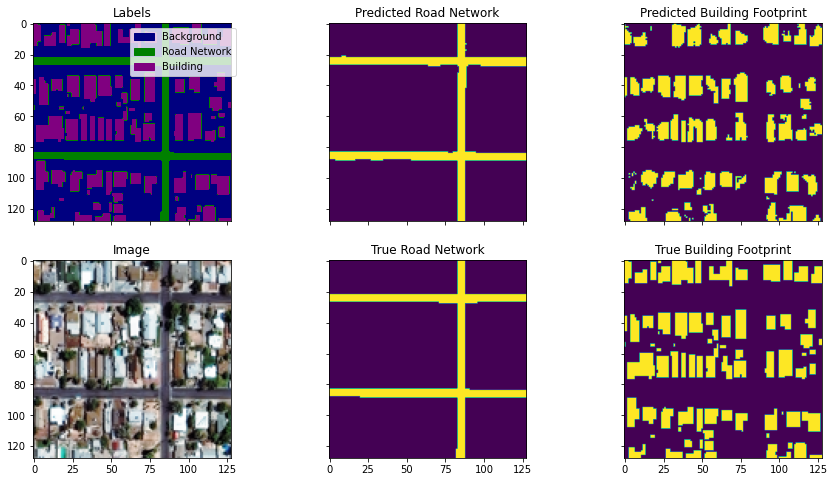

model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'BinaryCrossentropy'}


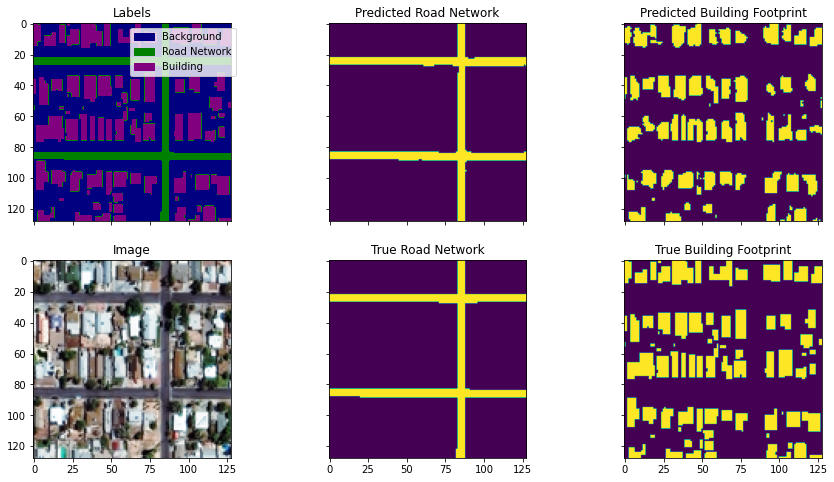

res_model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': True, 'loss': 'dice_loss'}


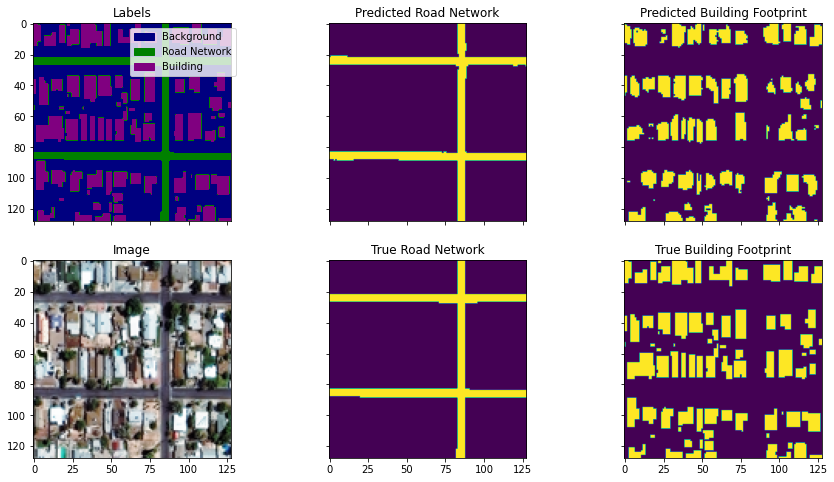

res_model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': True, 'loss': 'BinaryCrossentropy'}


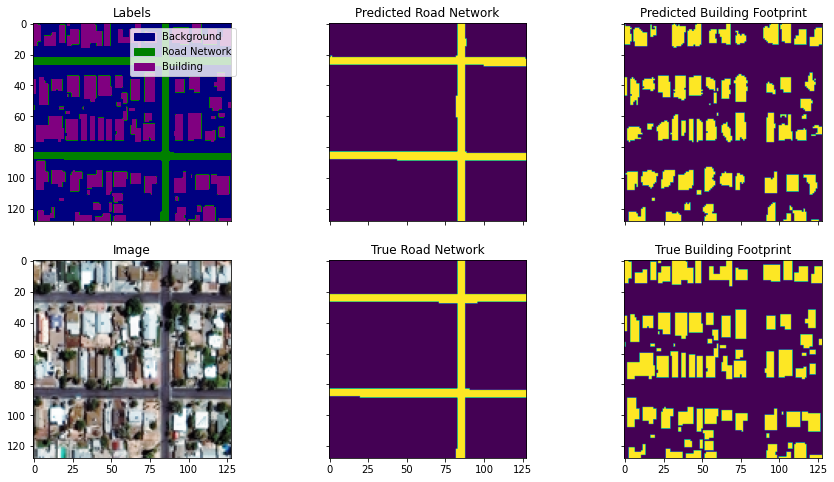

attention_model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'dice_loss'}


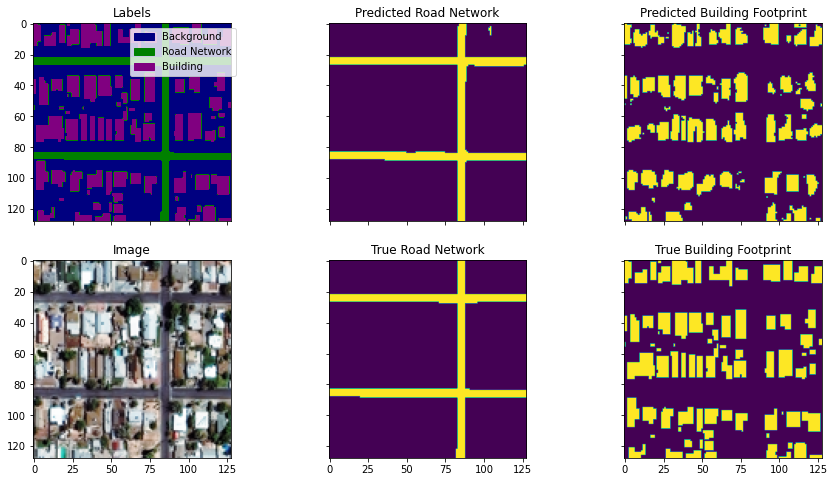

attention_model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'BinaryCrossentropy'}


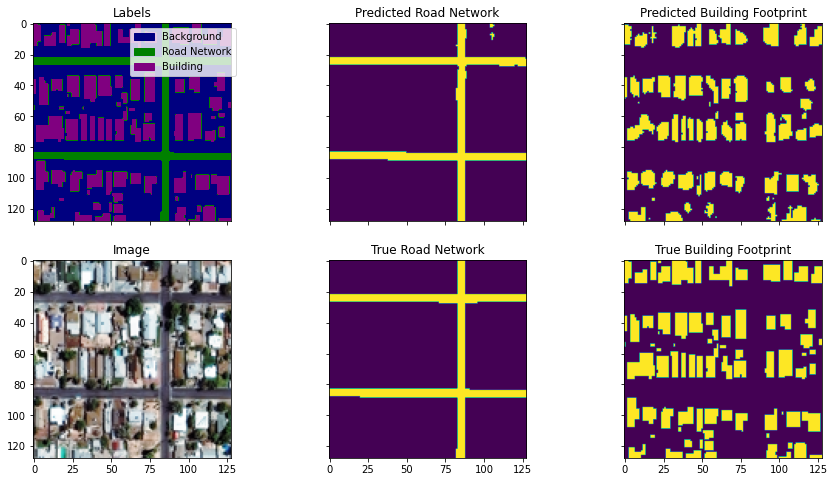

('..\\data_cleaning_EDA\\final_images_small\\SN3_roads_train_AOI_3_Paris_PS-RGB_img197_b.png', <Augment.LRFLIP: 2>)
('..\\data_cleaning_EDA\\final_masks_small\\SN3_roads_train_AOI_3_Paris_PS-RGB_img197_b.npy', <Augment.LRFLIP: 2>)


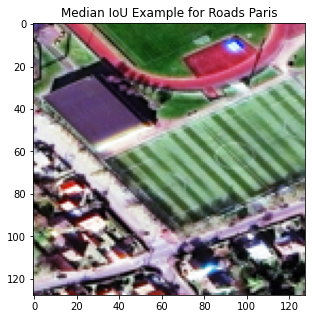

efficient_model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'dice_loss'}


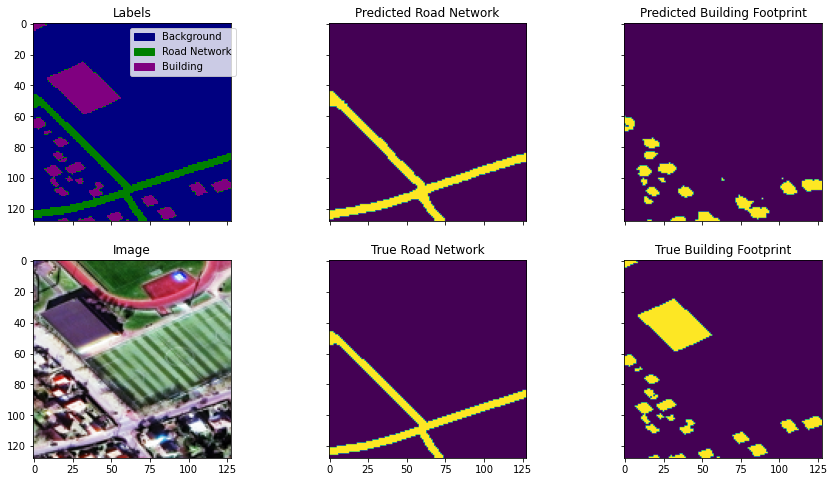

efficient_model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'BinaryCrossentropy'}


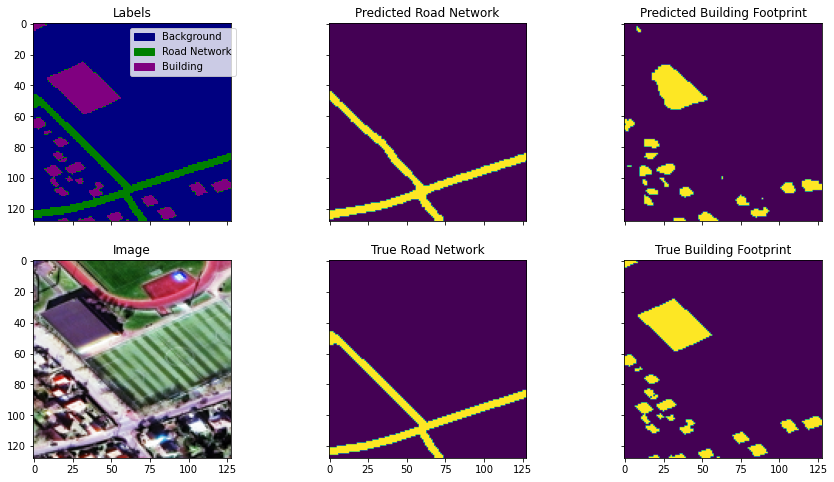

model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'dice_loss'}


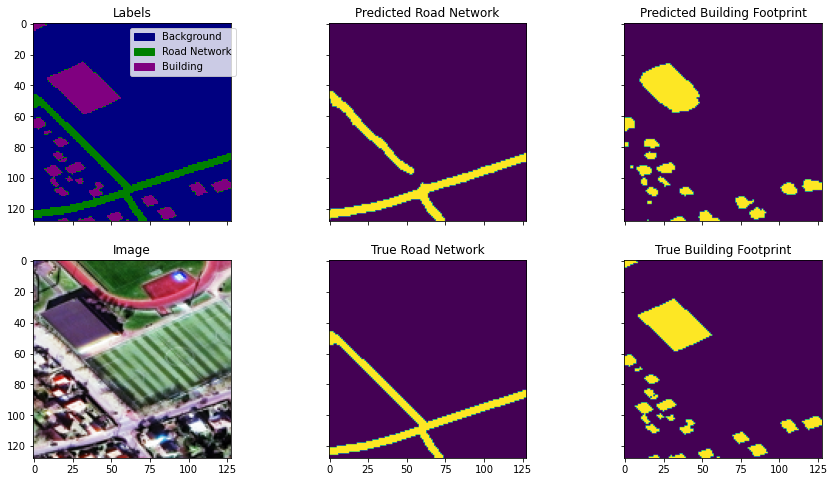

model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'BinaryCrossentropy'}


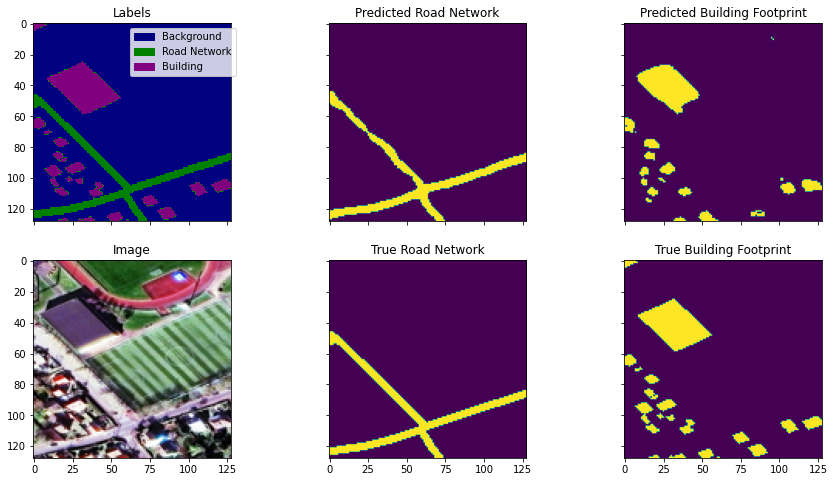

res_model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': True, 'loss': 'dice_loss'}


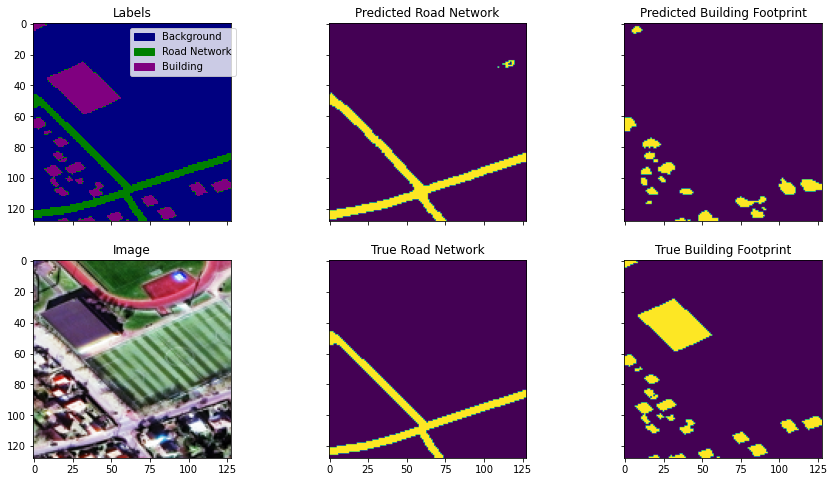

res_model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': True, 'loss': 'BinaryCrossentropy'}


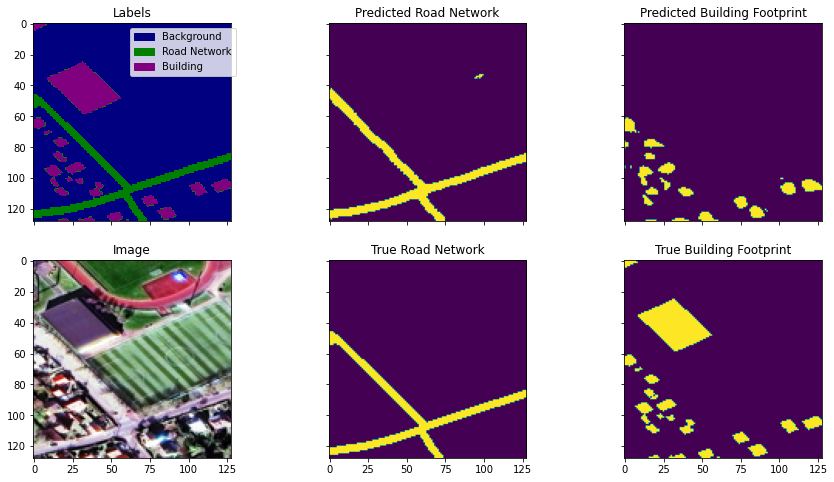

attention_model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'dice_loss'}


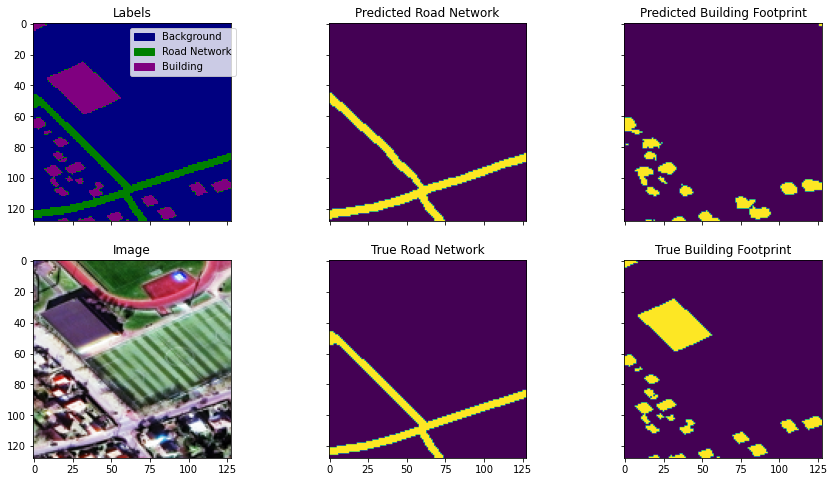

attention_model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'BinaryCrossentropy'}


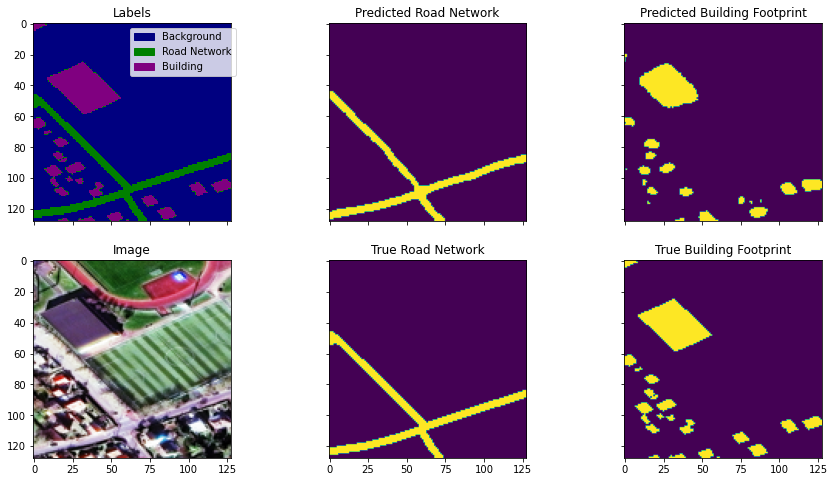

('..\\data_cleaning_EDA\\final_images_small\\SN3_roads_train_AOI_4_Shanghai_PS-RGB_img1238_b.png', <Augment.ROT90: 4>)
('..\\data_cleaning_EDA\\final_masks_small\\SN3_roads_train_AOI_4_Shanghai_PS-RGB_img1238_b.npy', <Augment.ROT90: 4>)


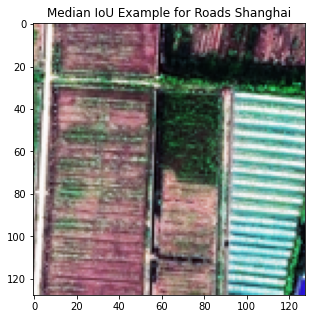

efficient_model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'dice_loss'}


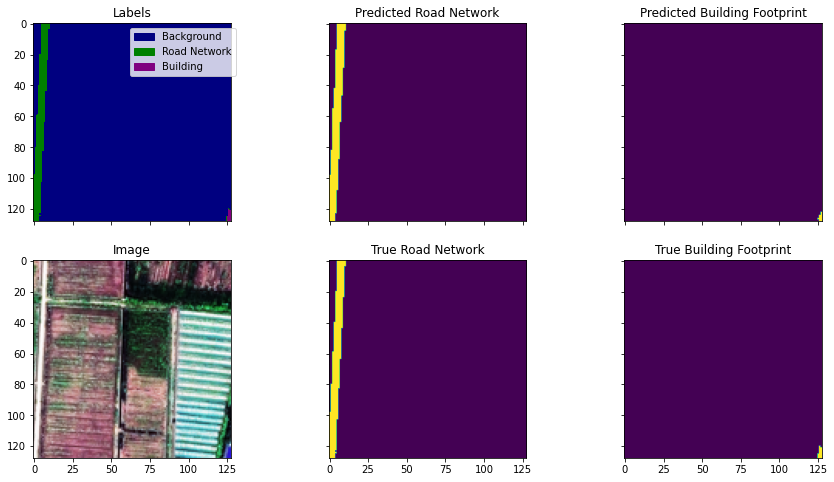

efficient_model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'BinaryCrossentropy'}


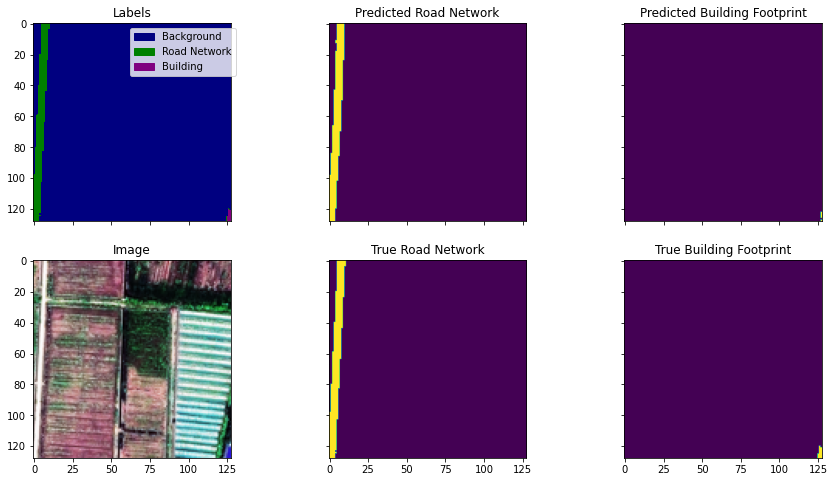

model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'dice_loss'}


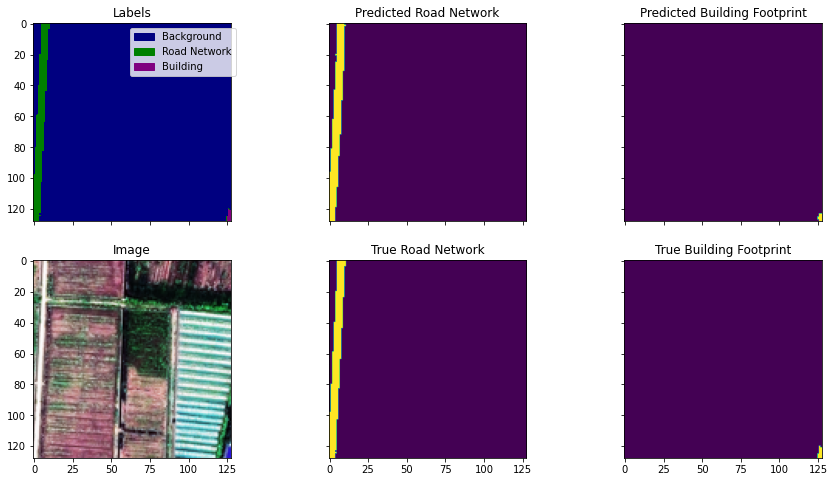

model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'BinaryCrossentropy'}


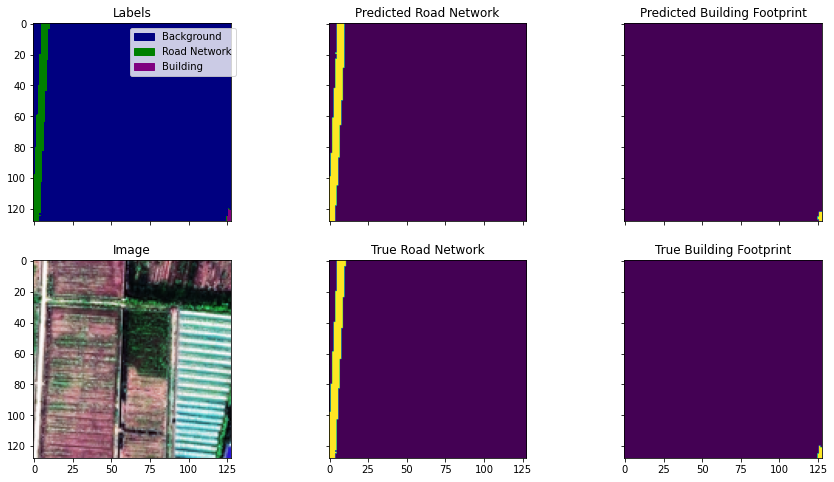

res_model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': True, 'loss': 'dice_loss'}


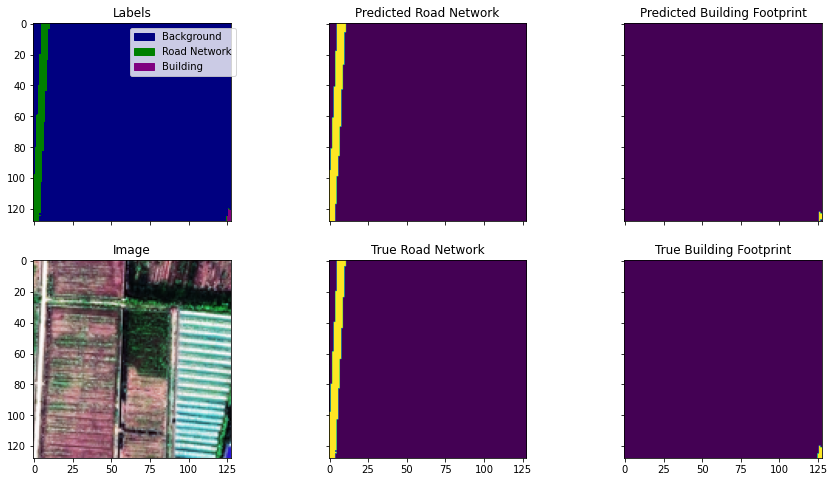

res_model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': True, 'loss': 'BinaryCrossentropy'}


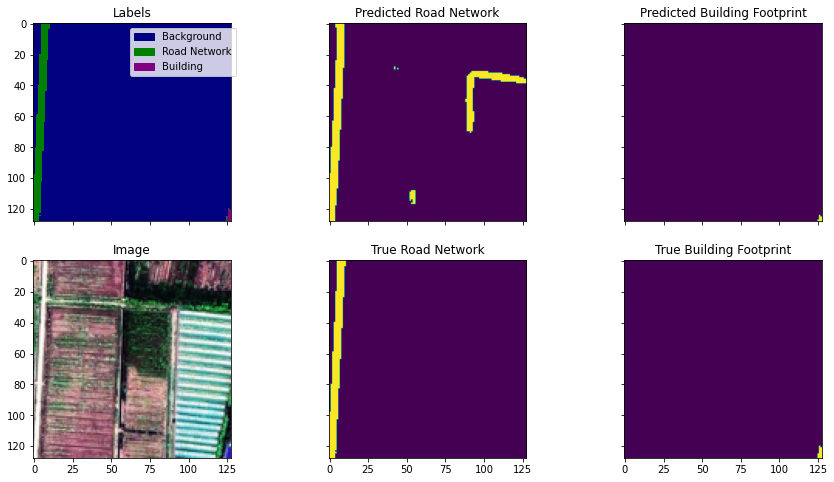

attention_model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'dice_loss'}


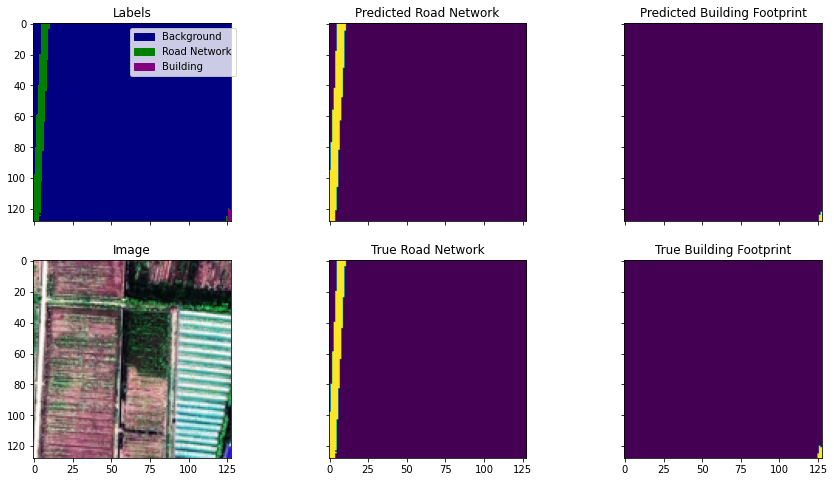

attention_model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'BinaryCrossentropy'}


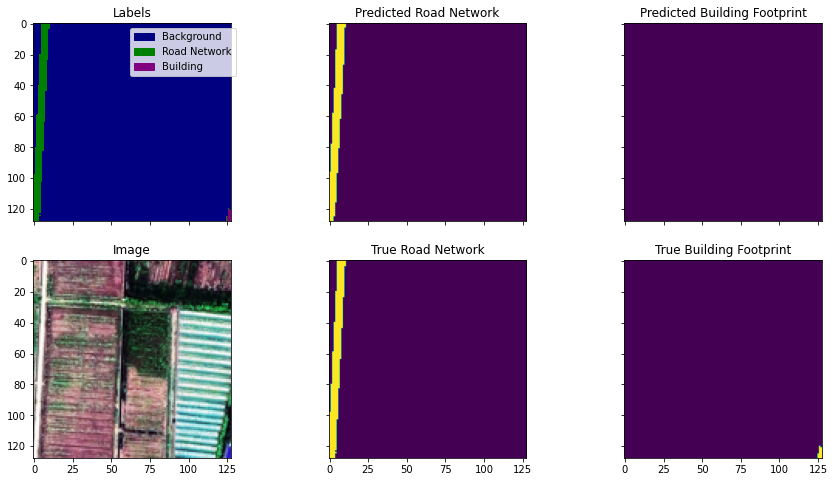

('..\\data_cleaning_EDA\\final_images_small\\SN3_roads_train_AOI_5_Khartoum_PS-RGB_img426_a.png', <Augment.ORIGINAL: 1>)
('..\\data_cleaning_EDA\\final_masks_small\\SN3_roads_train_AOI_5_Khartoum_PS-RGB_img426_a.npy', <Augment.ORIGINAL: 1>)


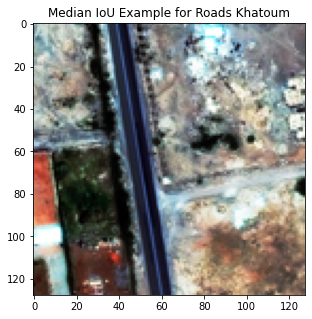

efficient_model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'dice_loss'}


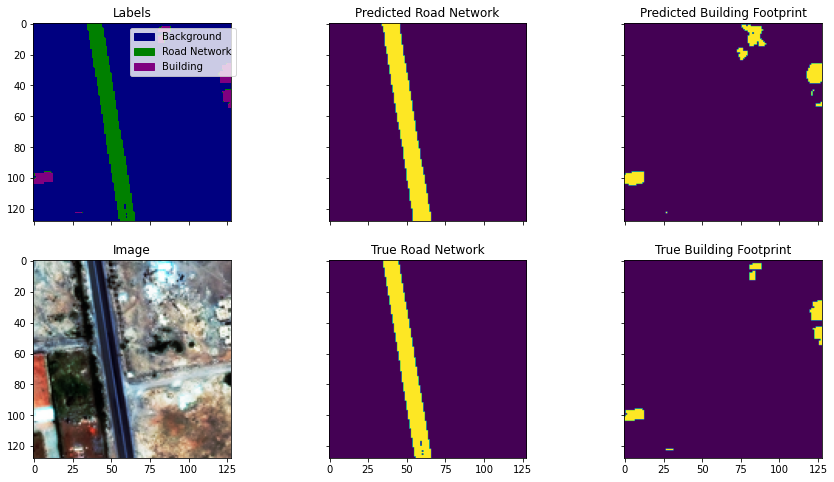

efficient_model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'BinaryCrossentropy'}


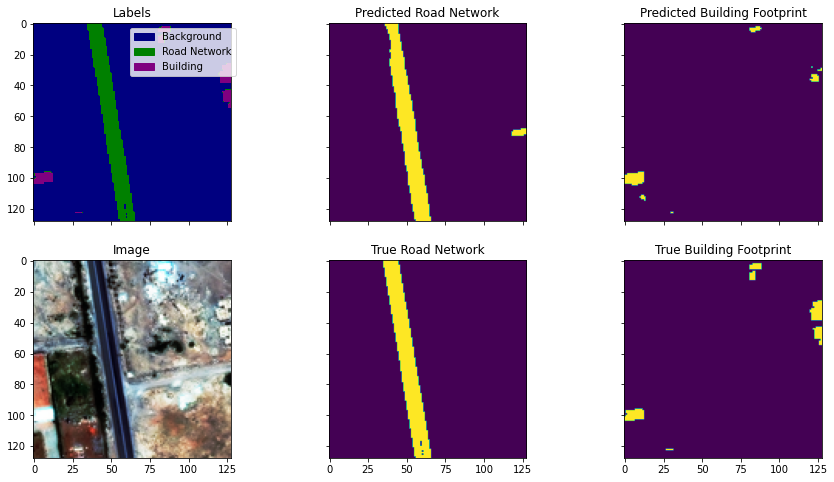

model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'dice_loss'}


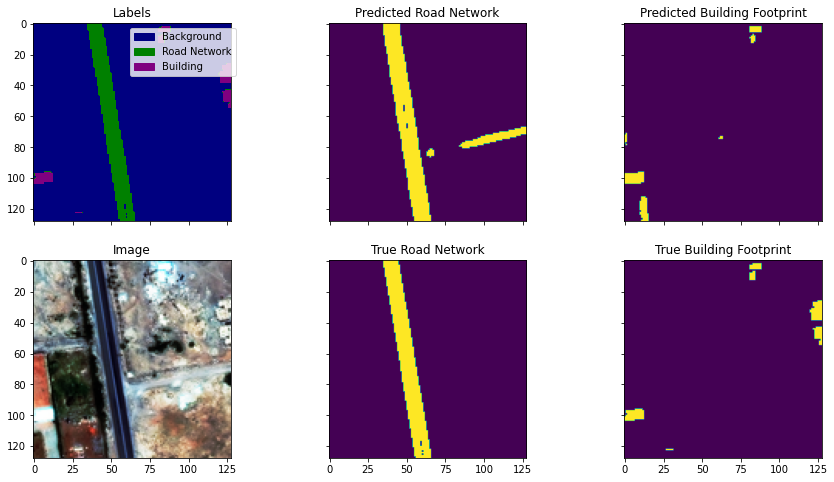

model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'BinaryCrossentropy'}


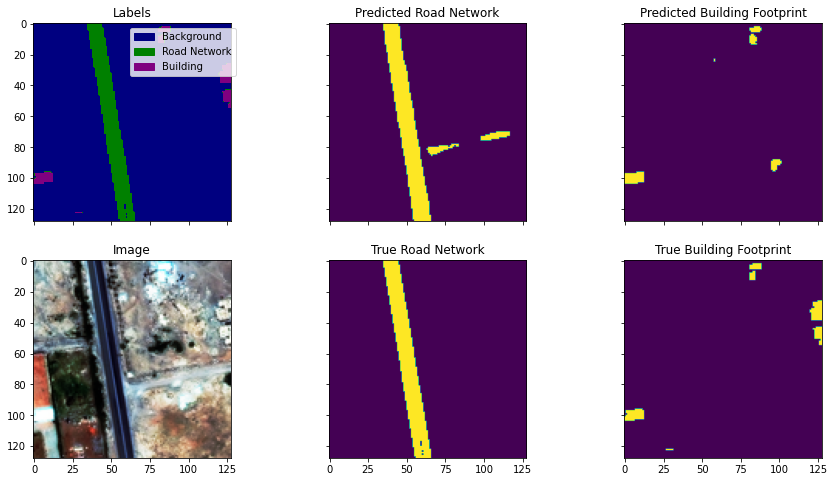

res_model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': True, 'loss': 'dice_loss'}


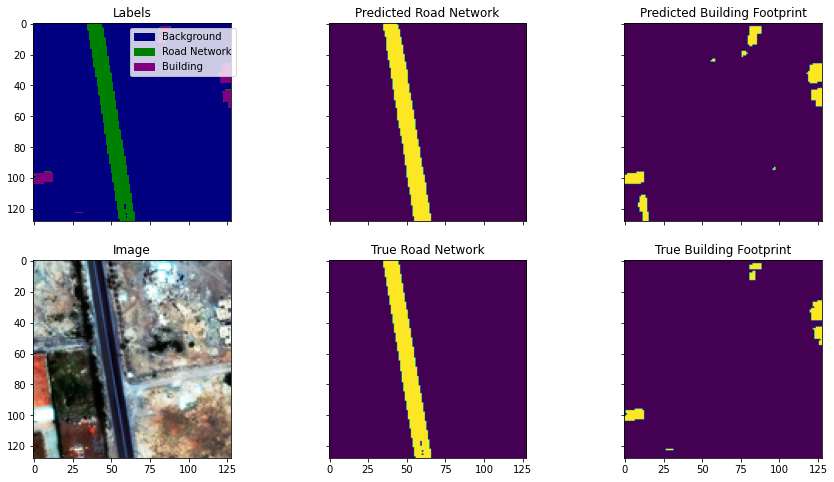

res_model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': True, 'loss': 'BinaryCrossentropy'}


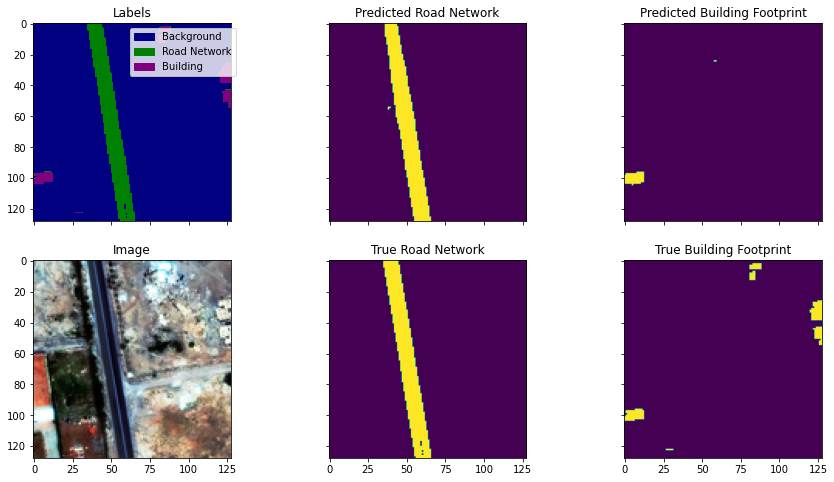

attention_model_dice {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'dice_loss'}


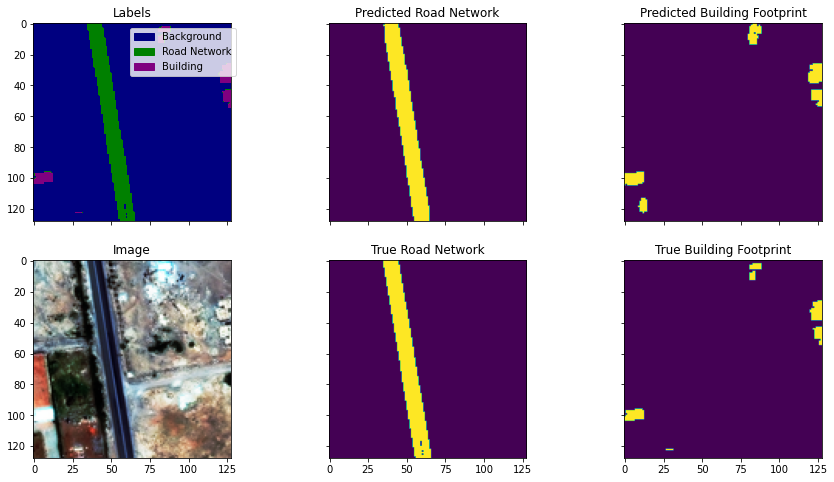

attention_model_entropy {'unet_levels': 4, 'number_of_start_kernels': 32, 'pooling_amount': 2, 'residual': False, 'loss': 'BinaryCrossentropy'}


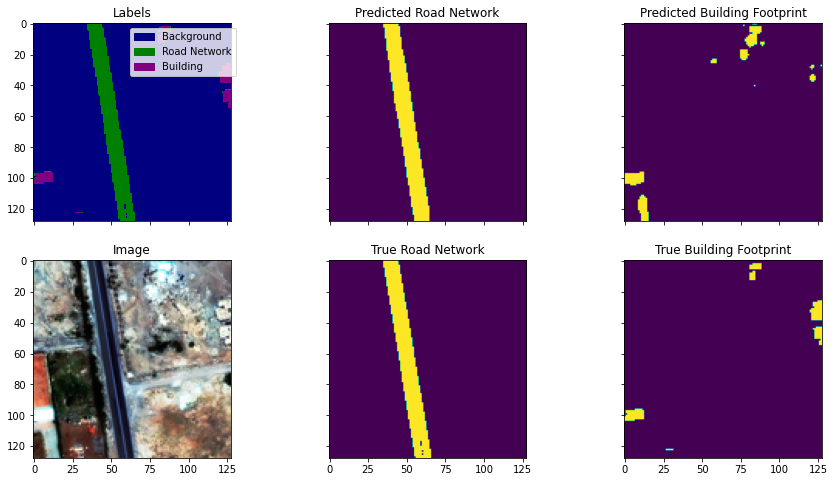

In [22]:
for g, aoi in enumerate(["Las Vegas", "Paris", "Shanghai", "Khatoum"]):
    k= best_road_index[g]

    batch = math.floor(k / test_data.batch_size) 
    index = k - batch * test_data.batch_size
    print(test_data.x[k])
    print(test_data.y[k])
    X_test_batch, y_test_batch = test_data.__getitem__(batch)
    plt.figure(figsize=(5, 5))
    plt.title(f'Median IoU Example for Roads {aoi}')
    plt.imshow(X_test_batch[index, :, :])
    plt.show()
    for model_name, model_config in model_configurations.items():
        print(model_name, model_config)
        if os.path.exists(model_name):
            plot_result(X_test_batch, y_test_batch, model_name=model_name, display_prob=False, index=index)
            plt.show()

### Above we have only performed a brief visual inspection of a few images. In the `iou_metric_comparison.ipynb` notebook, we perform a statistical test to see which models perform the best on average with respect to the IoU metric.